# Libraries

In [ ]:
# pip install -r req.txt

In [1]:
pip install plotly sympy ccxt tensorflow keras.wrappers scikit-learn scikit-optimize

Defaulting to user installation because normal site-packages is not writeable
ERROR: Could not find a version that satisfies the requirement keras.wrappers (from versions: none)
ERROR: No matching distribution found for keras.wrappers
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [2]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, kpss
from datetime import datetime as dt
import plotly.graph_objects as go
from scipy.stats import mstats
from datetime import timedelta
import matplotlib.pyplot as plt
from sympy import symbols
import pandas_ta as ta
import seaborn as sns
import pandas as pd
import scipy.stats
import numpy as np
import ccxt
import platform
from sklearn.preprocessing import StandardScaler

from sklearn.model_selection import train_test_split

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import (KFold, cross_val_score)

from sklearn import metrics
from sklearn.metrics import (classification_report, confusion_matrix)
from sklearn.svm import (SVC)


import tensorflow as tf
from tensorflow import keras
from keras import Input
from keras.models import Sequential
from keras.layers import Dense
from scikeras.wrappers import KerasClassifier

from sklearn.model_selection import TimeSeriesSplit, cross_val_score, train_test_split
from skopt import BayesSearchCV
from sklearn.svm import SVC

from keras.optimizers import Adam
from sklearn.model_selection import ParameterGrid
from scikeras.wrappers import KerasClassifier

/Users/amatic/Library/Python/3.9/lib/python/site-packages/urllib3/__init__.py:34: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


# Data Collection

>We define the tickers used in the study

In [3]:
paper_tickers = ['EOS', 'BCH', 'IOTA', 'XRP', 'OMG', 'ETC', 'XMR', 'LTC', 'ZEC', 'DASH', 'ETH', 'BTC']

> Calculating period length

In [4]:
# Paper Specification
# "10 August 2017 and is stillavailable on the last day of our sample, 23 June 2018"

paper_start_date = dt.strptime('10-08-2017 00:00:00', '%d-%m-%Y %H:%M:%S')
paper_end_date = dt.strptime('23-06-2018 00:00:00', '%d-%m-%Y %H:%M:%S')

number_of_days = (paper_end_date - paper_start_date).days
print(f'Number of days considered in paper: {number_of_days}')

Number of days considered in paper: 317


> Selecting time period for our use case

In [5]:
yesterday = dt.strptime('15-12-2023 00:00:00', '%d-%m-%Y %H:%M:%S')
start_point = yesterday - timedelta(days=number_of_days)

print(f'Our starting Point: {start_point}')

Our starting Point: 2023-02-01 00:00:00


> Utilising CCXT to pull data points

In [6]:
def _fetch_historical_data(exchange_id, symbol, since_millis, timeframe, limit=1000):
    exchange_class = getattr(ccxt, exchange_id)

    exchange = exchange_class({
        'rateLimit': limit,
        'enableRateLimit': True,
    })

    # # Convert the 'since' date to milliseconds for CCXT
    since_millis = int(dt.strptime(since_millis, '%Y-%m-%d').timestamp() * 1000)

    ohlcv =  exchange.fetch_ohlcv(symbol, timeframe, since=since_millis, limit=limit)

    ohlcv_list = []
    ohlcv_list += ohlcv

    firstRun = True

    while True:
        if firstRun:
            from_ts = ohlcv[-1][0]
            firstRun = False
        else:
            from_ts = new_ohlcv[-1][0]

        new_ohlcv = exchange.fetch_ohlcv(symbol, timeframe, since=from_ts, limit=limit)
        ohlcv_list +=  new_ohlcv

        if len(new_ohlcv)!=limit:
            break

    return ohlcv_list

def get_df_crypo_info(tickers: list, exchange_id='binance', start_date='2023-02-01', time_frame='15m'):
    '''
    ##############
    Example usage

        exchange_id = 'binance'  # You can use other exchanges supported by CCXT
        symbol = 'BTC/USDT'  # Cryptocurrency pair
        since_date = '2023-06-01'  # Start date for historical data
        timeframe = '15m'  # 1 day timeframe

        # Each entry is [timestamp, open, high, low, close, volume]
    '''

    list_failed = []
    list_fetched = []
    for _symbol in [t + "/USDT" for t in tickers]:

        try:
            data = _fetch_historical_data(exchange_id, _symbol, start_date, time_frame)

        except Exception as e:
            print(f'Fetch Failed For: {_symbol}: {e}')
            list_failed.append(_symbol)
            continue

        else:

            _dict = {
                str(_symbol) : {
                    'timestamps' : [sublist[0] for sublist in data],
                    'open': [sublist[1] for sublist in data],
                    'high': [sublist[2] for sublist in data],
                    'low': [sublist[3] for sublist in data],
                    'close': [sublist[4] for sublist in data],
                    'volume': [sublist[5] for sublist in data]
                }
            }

            list_fetched.append(_dict)

    all_dfs = []  # List to store DataFrames for each ticker

    for ticker_data in list_fetched:
        for ticker, values in ticker_data.items():
            df = pd.DataFrame(values)
            df['timestamps'] = pd.to_datetime(df['timestamps'], unit='ms')
            df.set_index('timestamps', inplace=True)
            df.columns = pd.MultiIndex.from_product([[ticker], df.columns])
            all_dfs.append(df)

    try:
        # Concatenate all DataFrames
        combined_df = pd.concat(all_dfs, axis=1)
    except Exception as e:
        combined_df = all_dfs
        print(e)

    return list_failed, combined_df

> Save data to CSV (functions commented since files already generated)

In [7]:
for tf in ['1d', '1h', '30m']:
    # failed, inter = get_df_crypo_info(tickers=paper_tickers, time_frame=tf)
    # inter.to_csv(f'ticker_{tf}.csv')
    # print(f'ticker_{tf}')
    print(f'{tf} done')
    # time.sleep(5)

1d done
1h done
30m done


In [8]:
tf ='15m'
for _symbol in paper_tickers:
    # failed, inter = get_df_crypo_info(tickers=[_symbol], time_frame=tf)
    # inter.to_csv(f'{_symbol}_{tf}.csv')
    # print(f'{_symbol}@{tf}')
    print(f'{_symbol} done')
    # time.sleep(5)

EOS done
BCH done
IOTA done
XRP done
OMG done
ETC done
XMR done
LTC done
ZEC done
DASH done
ETH done
BTC done


# EDA

> Loading Data (We choose to replicate study using 15m and 1h dataset intervals)

In [9]:
h1_data = pd.read_csv('ticker_data_1h.csv', header=[0, 1], index_col=0)

m15_data_raw = [pd.read_csv(f'./Data/{tick}_15m.csv', header=[0, 1], index_col=0) for tick in paper_tickers]
m15_data = pd.concat(m15_data_raw, axis=1)

## Visualization

### Hourly Data

In [10]:
h1_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7666 entries, 2023-01-31 23:00:00 to 2023-12-17 02:00:00
Data columns (total 60 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   (EOS/USDT, open)     7666 non-null   float64
 1   (EOS/USDT, high)     7666 non-null   float64
 2   (EOS/USDT, low)      7666 non-null   float64
 3   (EOS/USDT, close)    7666 non-null   float64
 4   (EOS/USDT, volume)   7666 non-null   float64
 5   (BCH/USDT, open)     7666 non-null   float64
 6   (BCH/USDT, high)     7666 non-null   float64
 7   (BCH/USDT, low)      7666 non-null   float64
 8   (BCH/USDT, close)    7666 non-null   float64
 9   (BCH/USDT, volume)   7666 non-null   float64
 10  (IOTA/USDT, open)    7666 non-null   float64
 11  (IOTA/USDT, high)    7666 non-null   float64
 12  (IOTA/USDT, low)     7666 non-null   float64
 13  (IOTA/USDT, close)   7666 non-null   float64
 14  (IOTA/USDT, volume)  7666 non-null   float64
 15  (XRP/USDT,

In [11]:
h1_data.describe()

EOS/USDT                                                       \
              open         high          low        close        volume   
count  7666.000000  7666.000000  7666.000000  7666.000000  7.666000e+03   
mean      0.824733     0.828811     0.820261     0.824720  5.686655e+05   
std       0.222304     0.223717     0.220863     0.222266  7.961205e+05   
min       0.528000     0.530000     0.517000     0.527000  0.000000e+00   
25%       0.635000     0.638000     0.631000     0.634250  2.195592e+05   
50%       0.745500     0.749000     0.742000     0.746000  3.627308e+05   
75%       1.041000     1.045000     1.035000     1.041000  6.293539e+05   
max       1.323000     1.341000     1.306000     1.323000  2.379694e+07   

          BCH/USDT                                                        ...  \
              open         high          low        close         volume  ...   
count  7666.000000  7666.000000  7666.000000  7666.000000    7666.000000  ...   
mean    182.096634   183.070663   181.107644   182.106888    4901.802850  ...   
std      56.804481    57.281893    56.337245    56.805681   10429.143928  ...   
min      97.800000    99.400000    90.300000    97.800000       0.000000  ...   
25%     124.400000   124.800000   123.900000   124.400000    1012.203000  ...   
50%     192.500000   193.400000   191.800000   192.500000    1997.381000  ...   
75%     233.075000   234.500000   231.700000   233.075000    4463.333500  ...   
max     323.200000   329.000000   313.800000   323.200000  237922.808000  ...   

          ETH/USDT                                                        \
              open         high          low        close         volume   
count  7666.000000  7666.000000  7666.000000  7666.000000    7666.000000   
mean   1803.036093  1808.602527  1797.219713  1803.121272   15178.624785   
std     175.786197   176.553490   174.987741   175.830744   16452.943748   
min    1379.550000  1388.800000  1368.390000  1379.560000       0.000000   
25%    1650.500000  1655.132500  1645.295000  1650.500000    6090.608100   
50%    1816.565000  1822.515000  1811.635000  1816.590000   10333.464000   
75%    1890.007500  1894.990000  1884.815000  1890.047500   17830.125875   
max    2383.110000  2403.000000  2369.800000  2383.100000  229509.369000   

           BTC/USDT                                                          
               open          high           low         close        volume  
count   7666.000000   7666.000000   7666.000000   7666.000000   7666.000000  
mean   28989.777558  29072.981164  28904.960985  28992.227434   3676.393554  
std     4721.818189   4736.774914   4706.686207   4723.643866   6292.810212  
min    19622.770000  19802.240000  19549.090000  19621.660000      0.000000  
25%    26316.020000  26394.212500  26245.257500  26320.225000    782.322280  
50%    27916.880000  27988.255000  27854.060000  27916.970000   1360.470320  
75%    30231.557500  30293.415000  30152.235000  30233.062500   3179.415280  
max    44527.340000  44700.000000  44239.020000  44527.340000  80041.752040  

[8 rows x 60 columns]

> Plot Closing Prices

In [ ]:
def make_subplot_by_column_vs_time(data, tar_column):
    close_columns = [col for col in data.columns if tar_column in col[1]]

    num_subplots = len(close_columns)
    num_columns = 2
    num_rows = (num_subplots + 1) // num_columns

    fig, axes = plt.subplots(num_rows, num_columns, figsize=(14, num_rows * 4))
    axes = axes.flatten()

    # Plotting each 'close' column in a subplot
    for i, col in enumerate(close_columns):
        data[col].plot(ax=axes[i])
        axes[i].set_title(f'{tar_column} of {col[0]}')
        axes[i].set_ylabel('Price (USD/$)')
        axes[i].set_xlabel('Date')

    plt.tight_layout()
    plt.show()

In [ ]:
make_subplot_by_column_vs_time(h1_data, 'close')

In [ ]:
make_subplot_by_column_vs_time(h1_data, 'volume')

In [ ]:
def make_ohlc_subplot(data):

    for ticker in paper_tickers:

        fig = go.Figure(
        data=go.Ohlc(x=data.index,
                    open=data[(f'{ticker}/USDT','open')],
                    high=data[(f'{ticker}/USDT','high')],
                    low=data[(f'{ticker}/USDT','low')],
                    close=data[(f'{ticker}/USDT','close')]
                    )
        )

        fig.update(layout_xaxis_rangeslider_visible=True)
        fig.update_xaxes(title_text='Date')
        fig.update_yaxes(title_text='Price (USDT) $')
        fig.update_layout(title_text=f'{ticker}/USDT OLHC chart', title_x=0.5)
        fig.show()

In [ ]:
make_ohlc_subplot(h1_data)

### 15 Minute data

In [12]:
m15_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 30667 entries, 2023-01-31 23:00:00 to 2023-12-17 03:15:00
Data columns (total 60 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   (EOS/USDT, open)     30667 non-null  float64
 1   (EOS/USDT, high)     30667 non-null  float64
 2   (EOS/USDT, low)      30667 non-null  float64
 3   (EOS/USDT, close)    30667 non-null  float64
 4   (EOS/USDT, volume)   30667 non-null  float64
 5   (BCH/USDT, open)     30667 non-null  float64
 6   (BCH/USDT, high)     30667 non-null  float64
 7   (BCH/USDT, low)      30667 non-null  float64
 8   (BCH/USDT, close)    30667 non-null  float64
 9   (BCH/USDT, volume)   30667 non-null  float64
 10  (IOTA/USDT, open)    30667 non-null  float64
 11  (IOTA/USDT, high)    30667 non-null  float64
 12  (IOTA/USDT, low)     30667 non-null  float64
 13  (IOTA/USDT, close)   30667 non-null  float64
 14  (IOTA/USDT, volume)  30667 non-null  float64
 15  (XRP/USDT

In [13]:
m15_data.describe()

EOS/USDT                                                          \
               open          high           low         close        volume   
count  30667.000000  30667.000000  30667.000000  30667.000000  3.066700e+04   
mean       0.824735      0.826755      0.822583      0.824736  1.421928e+05   
std        0.222313      0.222977      0.221631      0.222289  2.556773e+05   
min        0.525000      0.528000      0.517000      0.525000  0.000000e+00   
25%        0.635000      0.636000      0.633000      0.635000  4.323475e+04   
50%        0.746000      0.747000      0.744000      0.746000  8.223380e+04   
75%        1.041000      1.043000      1.038000      1.041000  1.518030e+05   
max        1.340000      1.341000      1.319000      1.341000  9.124937e+06   

           BCH/USDT                                                           \
               open          high           low         close         volume   
count  30667.000000  30667.000000  30667.000000  30667.000000   30667.000000   
mean     182.108804    182.567036    181.640588    182.109143    1226.450852   
std       56.798961     57.023061     56.576723     56.798963    3092.381901   
min       93.400000     98.400000     90.300000     93.600000       0.000000   
25%      124.400000    124.600000    124.200000    124.400000     197.682500   
50%      192.500000    192.900000    192.200000    192.500000     436.176000   
75%      233.100000    233.700000    232.400000    233.100000    1021.058000   
max      324.700000    329.000000    321.700000    324.700000  105858.606000   

       ...      ETH/USDT                                            \
       ...          open          high           low         close   
count  ...  30667.000000  30667.000000  30667.000000  30667.000000   
mean   ...   1803.101224   1805.697313   1800.392241   1803.122775   
std    ...    175.854463    176.219533    175.466347    175.868386   
min    ...   1375.660000   1382.740000   1368.390000   1375.660000   
25%    ...   1650.500000   1652.625000   1648.400000   1650.500000   
50%    ...   1816.560000   1818.950000   1814.000000   1816.590000   
75%    ...   1890.330000   1892.805000   1887.540000   1890.345000   
max    ...   2400.210000   2403.000000   2387.540000   2400.220000   

                         BTC/USDT                                            \
             volume          open          high           low         close   
count  30667.000000  30667.000000  30667.000000  30667.000000  30667.000000   
mean    3796.948395  28992.052988  29030.761015  28952.032492  28992.679957   
std     5143.109788   4723.557846   4730.455436   4716.383789   4724.026933   
min        0.000000  19622.770000  19687.730000  19549.090000  19621.660000   
25%     1348.171550  26322.070000  26362.110000  26283.320000  26322.245000   
50%     2325.610200  27920.830000  27953.470000  27887.360000  27921.210000   
75%     4166.133650  30232.000000  30262.290000  30197.755000  30232.105000   
max    99634.070500  44563.950000  44700.000000  44428.000000  44563.950000   

                     
             volume  
count  30667.000000  
mean     918.612617  
std     1688.288204  
min        0.000000  
25%      176.450175  
50%      319.837170  
75%      777.127965  
max    29961.474690  

[8 rows x 60 columns]

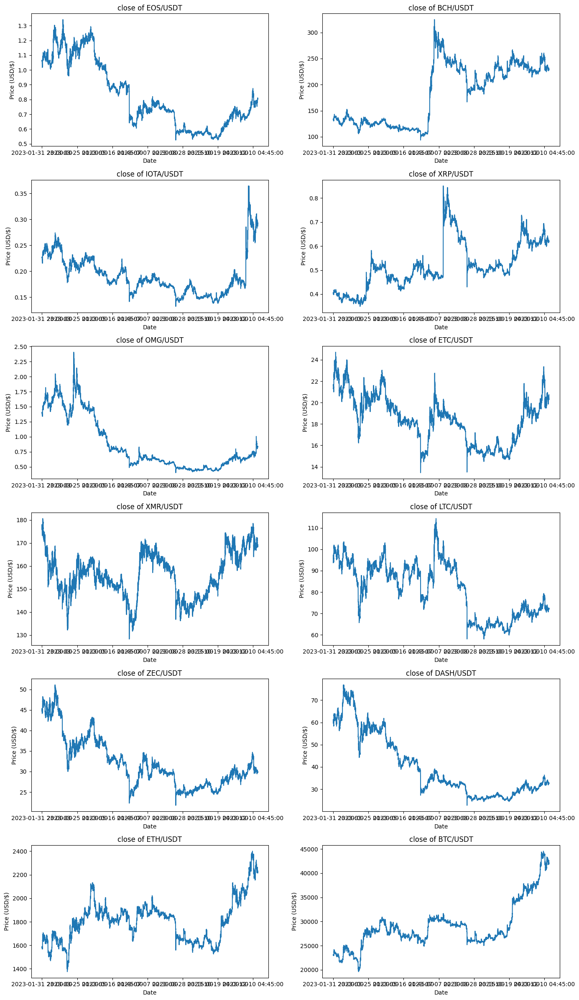

In [ ]:
make_subplot_by_column_vs_time(m15_data, 'close')

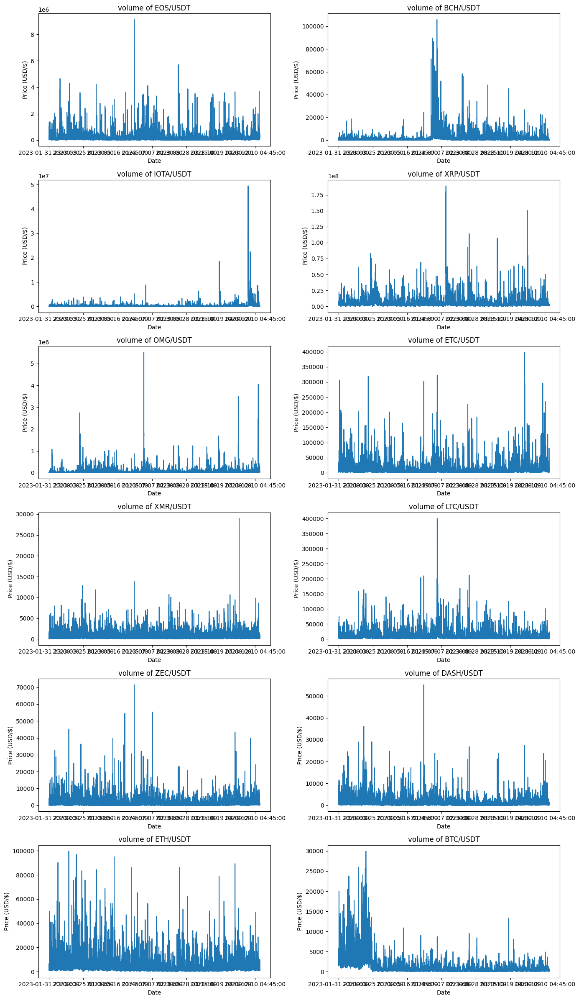

In [ ]:
make_subplot_by_column_vs_time(m15_data, 'volume')

In [ ]:
make_ohlc_subplot(m15_data)

## Missing Values and Duplicate Check

In [ ]:
h1_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7659 entries, 2023-01-31 23:00:00 to 2023-12-17 02:00:00
Data columns (total 60 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   (EOS/USDT, open)     7659 non-null   float64
 1   (EOS/USDT, high)     7659 non-null   float64
 2   (EOS/USDT, low)      7659 non-null   float64
 3   (EOS/USDT, close)    7659 non-null   float64
 4   (EOS/USDT, volume)   7659 non-null   float64
 5   (BCH/USDT, open)     7659 non-null   float64
 6   (BCH/USDT, high)     7659 non-null   float64
 7   (BCH/USDT, low)      7659 non-null   float64
 8   (BCH/USDT, close)    7659 non-null   float64
 9   (BCH/USDT, volume)   7659 non-null   float64
 10  (IOTA/USDT, open)    7659 non-null   float64
 11  (IOTA/USDT, high)    7659 non-null   float64
 12  (IOTA/USDT, low)     7659 non-null   float64
 13  (IOTA/USDT, close)   7659 non-null   float64
 14  (IOTA/USDT, volume)  7659 non-null   float64
 15  (XRP/USDT,

##### No null values in data

In [ ]:
#check for duplicate rows
duplicateRows = h1_data[h1_data.duplicated()]
duplicateRows_m15 = m15_data[m15_data.duplicated()]

In [ ]:
# Remove duplicate rows from the DataFrame
h1_data = h1_data.drop_duplicates()
m15_data = m15_data.drop_duplicates()


> Check if there is duplicates left

In [ ]:
#find duplicate rows across all columns
duplicateRows_m15 = m15_data[m15_data.duplicated()]
duplicateRows_m15

Empty DataFrame
Columns: [(EOS/USDT, open), (EOS/USDT, high), (EOS/USDT, low), (EOS/USDT, close), (EOS/USDT, volume), (BCH/USDT, open), (BCH/USDT, high), (BCH/USDT, low), (BCH/USDT, close), (BCH/USDT, volume), (IOTA/USDT, open), (IOTA/USDT, high), (IOTA/USDT, low), (IOTA/USDT, close), (IOTA/USDT, volume), (XRP/USDT, open), (XRP/USDT, high), (XRP/USDT, low), (XRP/USDT, close), (XRP/USDT, volume), (OMG/USDT, open), (OMG/USDT, high), (OMG/USDT, low), (OMG/USDT, close), (OMG/USDT, volume), (ETC/USDT, open), (ETC/USDT, high), (ETC/USDT, low), (ETC/USDT, close), (ETC/USDT, volume), (XMR/USDT, open), (XMR/USDT, high), (XMR/USDT, low), (XMR/USDT, close), (XMR/USDT, volume), (LTC/USDT, open), (LTC/USDT, high), (LTC/USDT, low), (LTC/USDT, close), (LTC/USDT, volume), (ZEC/USDT, open), (ZEC/USDT, high), (ZEC/USDT, low), (ZEC/USDT, close), (ZEC/USDT, volume), (DASH/USDT, open), (DASH/USDT, high), (DASH/USDT, low), (DASH/USDT, close), (DASH/USDT, volume), (ETH/USDT, open), (ETH/USDT, high), (ETH/USDT, low), (ETH/USDT, close), (ETH/USDT, volume), (BTC/USDT, open), (BTC/USDT, high), (BTC/USDT, low), (BTC/USDT, close), (BTC/USDT, volume)]
Index: []

[0 rows x 60 columns]

In [ ]:
#find duplicate rows across all columns
duplicateRows = h1_data[h1_data.duplicated()]
duplicateRows

Empty DataFrame
Columns: [(EOS/USDT, open), (EOS/USDT, high), (EOS/USDT, low), (EOS/USDT, close), (EOS/USDT, volume), (BCH/USDT, open), (BCH/USDT, high), (BCH/USDT, low), (BCH/USDT, close), (BCH/USDT, volume), (IOTA/USDT, open), (IOTA/USDT, high), (IOTA/USDT, low), (IOTA/USDT, close), (IOTA/USDT, volume), (XRP/USDT, open), (XRP/USDT, high), (XRP/USDT, low), (XRP/USDT, close), (XRP/USDT, volume), (OMG/USDT, open), (OMG/USDT, high), (OMG/USDT, low), (OMG/USDT, close), (OMG/USDT, volume), (ETC/USDT, open), (ETC/USDT, high), (ETC/USDT, low), (ETC/USDT, close), (ETC/USDT, volume), (XMR/USDT, open), (XMR/USDT, high), (XMR/USDT, low), (XMR/USDT, close), (XMR/USDT, volume), (LTC/USDT, open), (LTC/USDT, high), (LTC/USDT, low), (LTC/USDT, close), (LTC/USDT, volume), (ZEC/USDT, open), (ZEC/USDT, high), (ZEC/USDT, low), (ZEC/USDT, close), (ZEC/USDT, volume), (DASH/USDT, open), (DASH/USDT, high), (DASH/USDT, low), (DASH/USDT, close), (DASH/USDT, volume), (ETH/USDT, open), (ETH/USDT, high), (ETH/USDT, low), (ETH/USDT, close), (ETH/USDT, volume), (BTC/USDT, open), (BTC/USDT, high), (BTC/USDT, low), (BTC/USDT, close), (BTC/USDT, volume)]
Index: []

[0 rows x 60 columns]

## Outlier Visualization and Handling

In [ ]:
def make_histograms_by_columns(data: pd.DataFrame, target_column):
    num_tickers = len(paper_tickers)
    num_rows = (num_tickers + 1) // 2

    plt.figure(figsize=(12, 4 * num_rows))

    for index, iticker in enumerate(paper_tickers):
        mi_selector = (f'{iticker}/USDT', target_column)

        # Calculate values for normal distribution plot overlay
        mean_val = data[mi_selector].mean()
        std_val = data[mi_selector].std()
        x_norm = np.linspace(mean_val - 3 * std_val, mean_val + 3 * std_val, 100)
        y_norm = scipy.stats.norm.pdf(x_norm, mean_val, std_val)

        # Create subplots with two columns
        plt.subplot(num_rows, 2, index + 1)
        data[mi_selector].hist(bins=50, alpha=0.6, density=True, color='tab:orange')
        plt.plot(x_norm, y_norm, color='tab:red', linewidth=1.5)

        # Labels
        plt.xlabel(f'{iticker} {target_column}')
        plt.ylabel('Density')
        plt.title(f'{iticker} {target_column} Distribution')
        plt.grid(color='white', linestyle='-.', linewidth=0.5)
        ax = plt.gca()
        ax.set_facecolor('lightgrey')

    plt.tight_layout()
    plt.show()

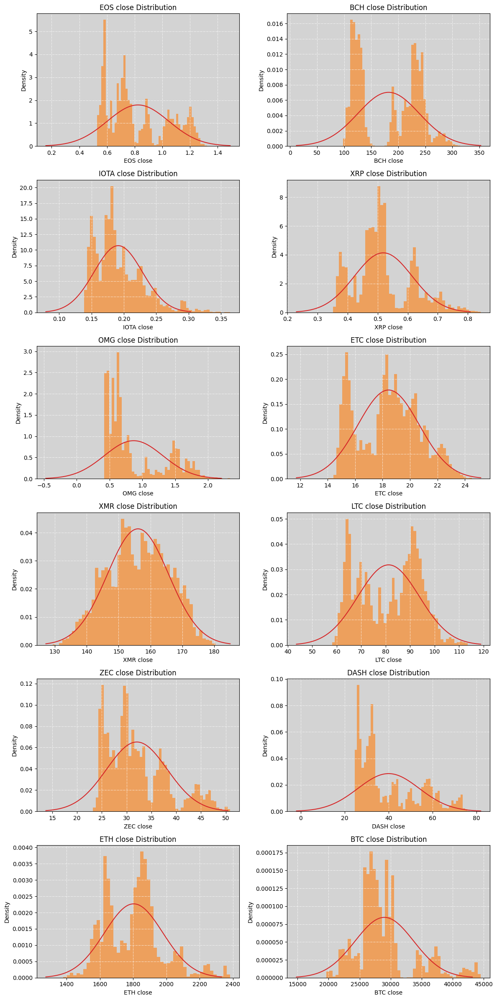

In [ ]:
make_histograms_by_columns(h1_data, 'close')

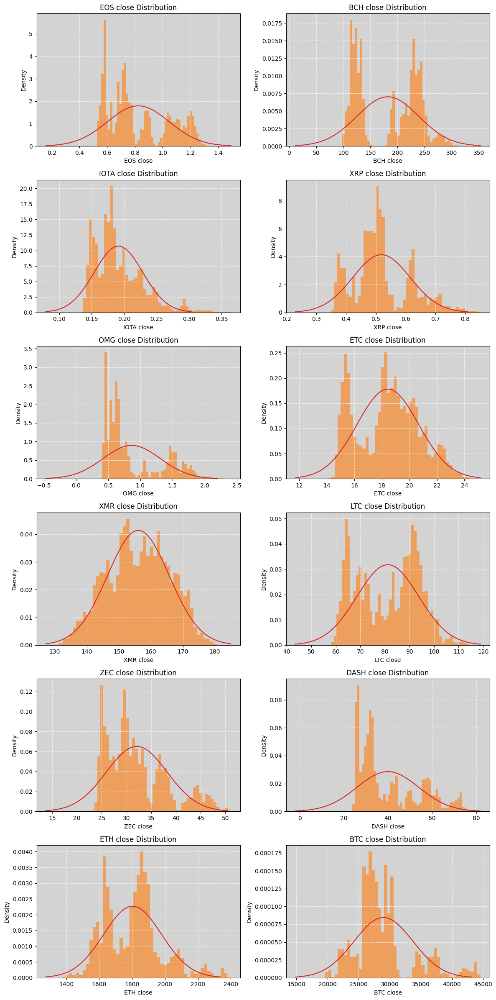

In [ ]:
make_histograms_by_columns(m15_data, 'close')

In [ ]:
def make_boxplot_by_columns(data: pd.DataFrame, target_column):
    num_tickers = len(paper_tickers)
    num_cols = 3
    num_rows = (num_tickers + num_cols - 1) // num_cols

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 2 * num_rows))
    axes = axes.flatten()

    for i, iticker in enumerate(paper_tickers):
        mi_selector = (f'{iticker}/USDT', target_column)
        ax = axes[i]
        ax.boxplot(data[mi_selector], vert=False)
        ax.set_title(f'{iticker} {target_column}')
        ax.grid(color='white', linestyle='-.', linewidth=0.5)

    fig.tight_layout()
    plt.show()

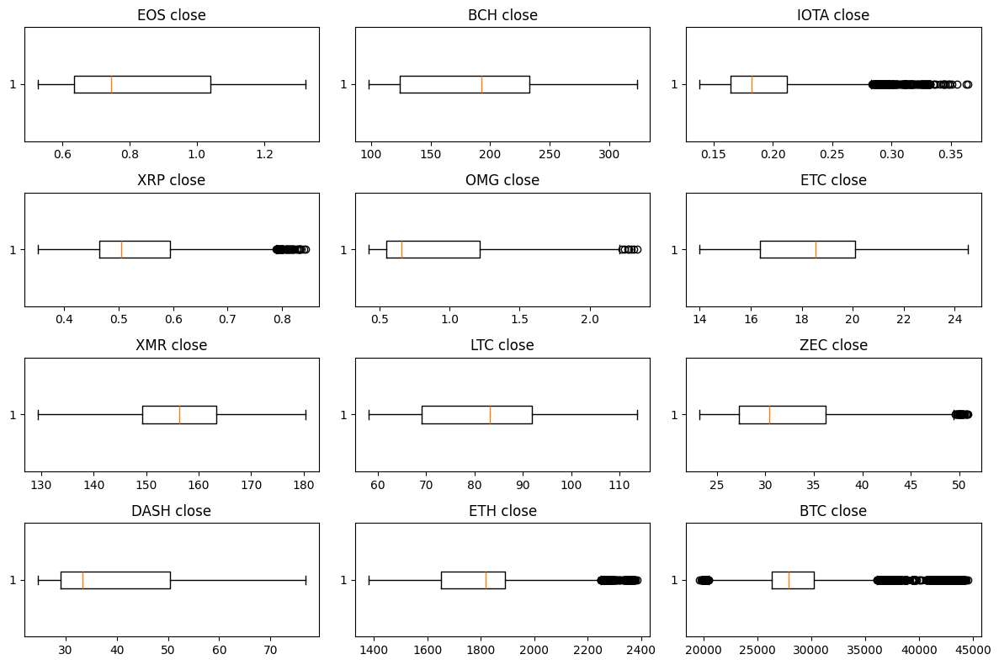

In [ ]:
make_boxplot_by_columns(h1_data, 'close')

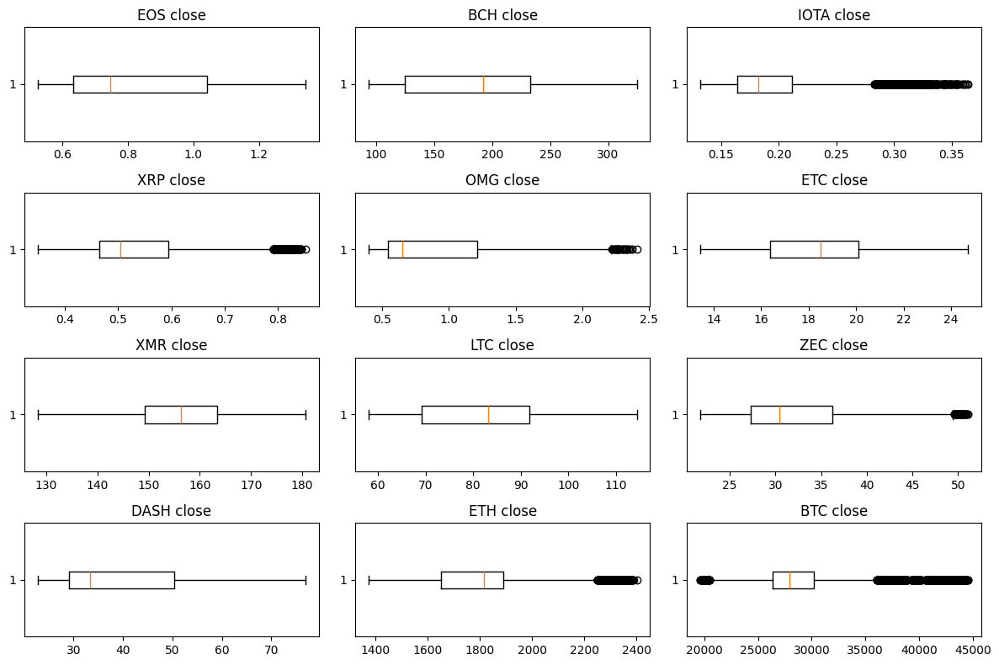

In [ ]:
make_boxplot_by_columns(m15_data, 'close')

In [ ]:
def get_skewness_kurtosis(data: pd.DataFrame, target_column):
    stats = []

    for iticker in paper_tickers:
        mi_selector = (f'{iticker}/USDT', target_column)

        skewness = data[mi_selector].skew()
        kurtosis = data[mi_selector].kurt()

        stats.append({
            'Ticker': iticker,
            'Skewness': skewness,
            'Kurtosis': kurtosis
        })

    stats_df = pd.DataFrame(stats).set_index('Ticker')

    return stats_df

In [ ]:
get_skewness_kurtosis(h1_data, 'close')

,Skewness,Kurtosis
Ticker,,
EOS,0.514252,-1.101201
BCH,0.044263,-1.561512
IOTA,1.155801,1.471172
XRP,0.634807,0.049678
OMG,1.002002,-0.433897
ETC,0.079441,-0.846802
XMR,-0.072002,-0.706181
LTC,-0.043603,-1.244944
ZEC,0.908455,0.093788


In [ ]:
get_skewness_kurtosis(m15_data, 'close')

,Skewness,Kurtosis
Ticker,,
EOS,0.514477,-1.100681
BCH,0.043994,-1.561534
IOTA,1.155692,1.470185
XRP,0.635714,0.056462
OMG,1.001613,-0.434557
ETC,0.079967,-0.844194
XMR,-0.071145,-0.704868
LTC,-0.043456,-1.246053
ZEC,0.907940,0.090969


> Winsorizing Outliers

In [ ]:
def gen_columns_selection(_select: dict):
    temp = list()

    for k, v in _select.items():
        for i in v:
            temp.append((k,i))

    return temp

def win_col_ret_df(data: pd.DataFrame, cols_to_win: list) -> pd.DataFrame:
    def using_mstats(s):
        return mstats.winsorize(s, limits=[0.01, 0.05])

    temp_df = data.copy(deep=True)

    for tar_col in cols_to_win:
        temp_df[tar_col] = using_mstats(temp_df[tar_col])

    return temp_df


In [ ]:
columns_to_winsorize = {
    'IOTA/USDT': ['close'],
    'XRP/USDT': ['close'],
    'OMG/USDT': ['close'],
    'ZEC/USDT': ['close'],
    'ETH/USDT': ['close'],
    'BTC/USDT': ['close'],
}

_to_win_select = gen_columns_selection(columns_to_winsorize)

In [ ]:
d1_data_p_win = win_col_ret_df(h1_data, _to_win_select)
d1_data_p_win.head()

EOS/USDT                                BCH/USDT         \
                        open   high    low  close    volume     open   high   
timestamps                                                                    
2023-01-31 23:00:00    1.064  1.066  1.057  1.063  346369.4    133.5  133.6   
2023-02-01 00:00:00    1.063  1.068  1.057  1.063  480248.0    133.3  134.3   
2023-02-01 01:00:00    1.064  1.066  1.058  1.063  302326.2    134.3  134.8   
2023-02-01 02:00:00    1.063  1.067  1.061  1.066  199846.1    134.5  134.8   
2023-02-01 03:00:00    1.067  1.067  1.059  1.063  165438.8    134.5  134.6   

                                             ... ETH/USDT                    \
                       low  close    volume  ...     open     high      low   
timestamps                                   ...                              
2023-01-31 23:00:00  132.9  133.3  1498.727  ...  1590.32  1590.74  1581.60   
2023-02-01 00:00:00  133.1  134.2  2471.556  ...  1585.32  1590.00  1576.43   
2023-02-01 01:00:00  133.8  134.4  2220.525  ...  1583.34  1592.94  1580.35   
2023-02-01 02:00:00  134.2  134.5   573.976  ...  1588.93  1589.44  1582.21   
2023-02-01 03:00:00  133.8  134.3   492.066  ...  1585.66  1585.98  1578.80   

                                          BTC/USDT                      \
                       close      volume      open      high       low   
timestamps                                                               
2023-01-31 23:00:00  1585.33  13718.7714  23181.81  23188.70  23081.19   
2023-02-01 00:00:00  1583.34  16798.7557  23125.13  23168.90  22997.10   
2023-02-01 01:00:00  1588.92  14006.6021  23085.36  23184.29  23055.25   
2023-02-01 02:00:00  1585.66   8378.3636  23123.10  23130.93  23078.50   
2023-02-01 03:00:00  1584.61   7889.1912  23107.17  23134.59  23038.07   

                                            
                        close       volume  
timestamps                                  
2023-01-31 23:00:00  23125.13  10955.34795  
2023-02-01 00:00:00  23085.73  12121.64019  
2023-02-01 01:00:00  23123.09   9512.34705  
2023-02-01 02:00:00  23108.43   7108.81617  
2023-02-01 03:00:00  23130.19   6963.14876  

[5 rows x 60 columns]

In [ ]:
d1_data_p_win_15min = win_col_ret_df(m15_data, _to_win_select)
d1_data_p_win_15min.head()

EOS/USDT                                BCH/USDT         \
                        open   high    low  close    volume     open   high   
timestamps                                                                    
2023-01-31 23:00:00    1.064  1.064  1.060  1.062   58036.7    133.5  133.6   
2023-01-31 23:15:00    1.062  1.065  1.057  1.061  161928.6    133.0  133.3   
2023-01-31 23:30:00    1.061  1.065  1.060  1.064   67104.9    133.0  133.3   
2023-01-31 23:45:00    1.064  1.066  1.063  1.063   59299.2    133.2  133.5   
2023-02-01 00:00:00    1.063  1.068  1.057  1.064  136083.3    133.3  133.9   

                                            ... ETH/USDT                    \
                       low  close   volume  ...     open     high      low   
timestamps                                  ...                              
2023-01-31 23:00:00  133.0  133.0  646.766  ...  1590.32  1590.74  1582.58   
2023-01-31 23:15:00  132.9  133.0  340.648  ...  1583.94  1585.78  1581.83   
2023-01-31 23:30:00  132.9  133.2  266.809  ...  1582.24  1586.22  1581.60   
2023-01-31 23:45:00  133.2  133.3  244.504  ...  1584.22  1587.63  1583.88   
2023-02-01 00:00:00  133.1  133.6  899.295  ...  1585.32  1590.00  1581.21   

                                         BTC/USDT                      \
                       close     volume      open      high       low   
timestamps                                                              
2023-01-31 23:00:00  1583.94  5807.7594  23181.81  23188.70  23081.19   
2023-01-31 23:15:00  1582.23  3165.8614  23106.53  23138.83  23082.00   
2023-01-31 23:30:00  1584.22  2291.8838  23108.09  23145.39  23100.03   
2023-01-31 23:45:00  1585.33  2453.2668  23122.40  23159.53  23120.41   
2023-02-01 00:00:00  1585.12  5683.5547  23125.13  23168.90  23037.43   

                                           
                        close      volume  
timestamps                                 
2023-01-31 23:00:00  23106.53  4106.51376  
2023-01-31 23:15:00  23108.09  2693.27525  
2023-01-31 23:30:00  23121.34  2110.23284  
2023-01-31 23:45:00  23125.13  2045.32610  
2023-02-01 00:00:00  23092.98  4483.43366  

[5 rows x 60 columns]

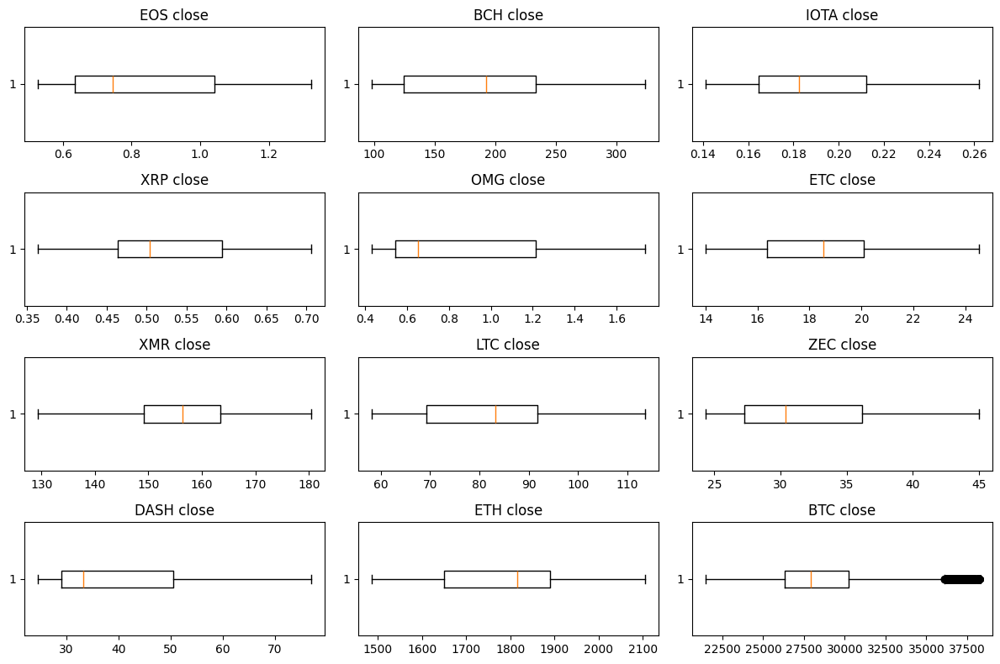

In [ ]:
make_boxplot_by_columns(d1_data_p_win, 'close')

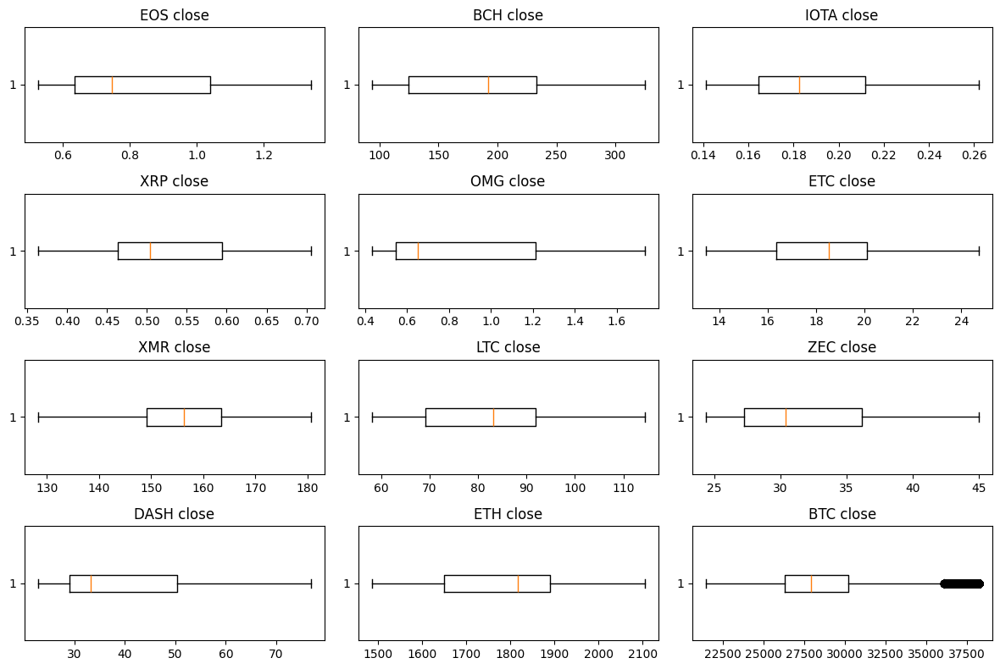

In [ ]:
make_boxplot_by_columns(d1_data_p_win_15min, 'close')

## Calculating log returns

In [ ]:
def get_output_var_from_df(data: pd.DataFrame):

        temp = pd.DataFrame()
        for iticker in paper_tickers:
                mi_close_selector = (f'{iticker}/USDT', 'close')
                mi_open_selector = (f'{iticker}/USDT', 'open')
                mi_output_selector = f'{iticker}/USDT'
                temp[mi_output_selector] = np.log((data[mi_close_selector].shift(-1))/(data[mi_open_selector].shift(-1)))

        return temp

In [ ]:
output_df = get_output_var_from_df(d1_data_p_win)
output_df.head(5)

,EOS/USDT,BCH/USDT,IOTA/USDT,XRP/USDT,OMG/USDT,ETC/USDT,XMR/USDT,LTC/USDT,ZEC/USDT,DASH/USDT,ETH/USDT,BTC/USDT
timestamps,,,,,,,,,,,,
2023-01-31 23:00:00,0.000000,0.006729,-0.002205,-0.006924,0.003568,-0.002309,0.000000,0.017280,-0.00222,-0.001662,-0.001250,-0.001705
2023-02-01 00:00:00,-0.000940,0.000744,0.000882,-0.002236,-0.000713,0.001386,-0.000564,0.010392,-0.00222,0.018781,0.003518,0.001633
2023-02-01 01:00:00,0.002818,0.000000,0.000882,0.001491,-0.001427,-0.000924,-0.005086,0.003199,-0.00222,-0.007208,-0.002060,-0.000635
2023-02-01 02:00:00,-0.003756,-0.001488,-0.000441,0.001241,-0.002855,-0.002313,-0.002269,-0.001856,-0.00222,-0.000823,-0.000662,0.000996
2023-02-01 03:00:00,-0.000942,-0.002983,-0.001324,0.005199,-0.000715,-0.001854,0.001135,0.006175,0.00000,-0.000494,-0.001035,0.000228


In [ ]:
output_df_15min = get_output_var_from_df(d1_data_p_win_15min)
output_df_15min.head(5)

,EOS/USDT,BCH/USDT,IOTA/USDT,XRP/USDT,OMG/USDT,ETC/USDT,XMR/USDT,LTC/USDT,ZEC/USDT,DASH/USDT,ETH/USDT,BTC/USDT
timestamps,,,,,,,,,,,,
2023-01-31 23:00:00,-0.000942,0.000000,-0.000441,-0.000985,-0.003568,0.000000,0.001692,0.002452,-0.004435,0.001339,-0.001080,0.000068
2023-01-31 23:15:00,0.002824,0.001503,0.001322,0.001724,0.000000,0.002771,0.001690,0.004250,-0.004435,0.002504,0.001251,0.000573
2023-01-31 23:30:00,-0.000940,0.000750,-0.000440,-0.001724,-0.000715,0.000000,-0.001689,-0.002441,-0.004435,0.003826,0.000700,0.000118
2023-01-31 23:45:00,0.000940,0.002248,0.001321,-0.001973,0.004280,-0.000461,0.002813,0.001168,-0.002220,0.007608,-0.000126,-0.001391
2023-02-01 00:00:00,-0.004710,-0.002248,-0.004413,-0.002473,-0.004998,-0.005089,-0.003938,0.001061,-0.006645,-0.003470,-0.002128,-0.002083


## Create target variable

In [ ]:
def get_target_from_df(data: pd.DataFrame):

        temp = pd.DataFrame()
        for iticker in data.columns:
                mi_returns_selector = f'{iticker}'
                temp[mi_returns_selector] = data[iticker].apply(lambda x: 1 if x > 0 else (-1 if x == 0 else 0))

        return temp

In [ ]:
target_df = get_target_from_df(output_df)
target_df.head(5)

,EOS/USDT,BCH/USDT,IOTA/USDT,XRP/USDT,OMG/USDT,ETC/USDT,XMR/USDT,LTC/USDT,ZEC/USDT,DASH/USDT,ETH/USDT,BTC/USDT
timestamps,,,,,,,,,,,,
2023-01-31 23:00:00,-1,1,0,0,1,0,-1,1,0,0,0,0
2023-02-01 00:00:00,0,1,1,0,0,1,0,1,0,1,1,1
2023-02-01 01:00:00,1,-1,1,1,0,0,0,1,0,0,0,0
2023-02-01 02:00:00,0,0,0,1,0,0,0,0,0,0,0,1
2023-02-01 03:00:00,0,0,0,1,0,0,1,1,-1,0,0,1


In [ ]:
target_df_15min = get_target_from_df(output_df_15min)
target_df_15min.head(5)

,EOS/USDT,BCH/USDT,IOTA/USDT,XRP/USDT,OMG/USDT,ETC/USDT,XMR/USDT,LTC/USDT,ZEC/USDT,DASH/USDT,ETH/USDT,BTC/USDT
timestamps,,,,,,,,,,,,
2023-01-31 23:00:00,0,-1,0,0,0,-1,1,1,0,1,0,1
2023-01-31 23:15:00,1,1,1,1,-1,1,1,1,0,1,1,1
2023-01-31 23:30:00,0,1,0,0,0,-1,0,0,0,1,1,1
2023-01-31 23:45:00,1,1,1,0,1,0,1,1,0,1,0,0
2023-02-01 00:00:00,0,0,0,0,0,0,0,1,0,0,0,0


### Droped all values where return is 0. There is no point prediciting three clases, as the paper doesn't observes this only as two class problem.

In [ ]:
def filter_and_drop(data: pd.DataFrame, value=-1):
    return data[~data.isin([value]).any(axis=1)]

filtered_target_df = filter_and_drop(target_df, value=-1)
filtered_target_df.info()
filtered_target_df.head(5)

<class 'pandas.core.frame.DataFrame'>
Index: 4447 entries, 2023-02-01 00:00:00 to 2023-12-17 02:00:00
Data columns (total 12 columns):
 #   Column     Non-Null Count  Dtype
---  ------     --------------  -----
 0   EOS/USDT   4447 non-null   int64
 1   BCH/USDT   4447 non-null   int64
 2   IOTA/USDT  4447 non-null   int64
 3   XRP/USDT   4447 non-null   int64
 4   OMG/USDT   4447 non-null   int64
 5   ETC/USDT   4447 non-null   int64
 6   XMR/USDT   4447 non-null   int64
 7   LTC/USDT   4447 non-null   int64
 8   ZEC/USDT   4447 non-null   int64
 9   DASH/USDT  4447 non-null   int64
 10  ETH/USDT   4447 non-null   int64
 11  BTC/USDT   4447 non-null   int64
dtypes: int64(12)
memory usage: 451.6+ KB


,EOS/USDT,BCH/USDT,IOTA/USDT,XRP/USDT,OMG/USDT,ETC/USDT,XMR/USDT,LTC/USDT,ZEC/USDT,DASH/USDT,ETH/USDT,BTC/USDT
timestamps,,,,,,,,,,,,
2023-02-01 00:00:00,0,1,1,0,0,1,0,1,0,1,1,1
2023-02-01 02:00:00,0,0,0,1,0,0,0,0,0,0,0,1
2023-02-01 04:00:00,0,0,0,0,0,0,0,0,0,0,1,0
2023-02-01 05:00:00,0,0,0,0,0,0,0,0,0,0,0,0
2023-02-01 06:00:00,1,1,1,1,1,1,1,0,1,1,1,1


In [ ]:
filtered_target_df_15min = filter_and_drop(target_df_15min, value=-1)
filtered_target_df_15min.info()
filtered_target_df_15min.head(5)

<class 'pandas.core.frame.DataFrame'>
Index: 11244 entries, 2023-01-31 23:45:00 to 2023-12-17 03:15:00
Data columns (total 12 columns):
 #   Column     Non-Null Count  Dtype
---  ------     --------------  -----
 0   EOS/USDT   11244 non-null  int64
 1   BCH/USDT   11244 non-null  int64
 2   IOTA/USDT  11244 non-null  int64
 3   XRP/USDT   11244 non-null  int64
 4   OMG/USDT   11244 non-null  int64
 5   ETC/USDT   11244 non-null  int64
 6   XMR/USDT   11244 non-null  int64
 7   LTC/USDT   11244 non-null  int64
 8   ZEC/USDT   11244 non-null  int64
 9   DASH/USDT  11244 non-null  int64
 10  ETH/USDT   11244 non-null  int64
 11  BTC/USDT   11244 non-null  int64
dtypes: int64(12)
memory usage: 1.1+ MB


,EOS/USDT,BCH/USDT,IOTA/USDT,XRP/USDT,OMG/USDT,ETC/USDT,XMR/USDT,LTC/USDT,ZEC/USDT,DASH/USDT,ETH/USDT,BTC/USDT
timestamps,,,,,,,,,,,,
2023-01-31 23:45:00,1,1,1,0,1,0,1,1,0,1,0,0
2023-02-01 00:00:00,0,0,0,0,0,0,0,1,0,0,0,0
2023-02-01 00:30:00,0,1,0,0,0,0,0,1,0,0,0,1
2023-02-01 01:00:00,0,0,0,0,0,0,0,1,0,1,0,0
2023-02-01 01:30:00,0,0,0,0,0,0,0,0,0,1,0,0


## Features from study

> Average True Range (ATR, period=10)

In [ ]:
def get_atr_from_df(data: pd.DataFrame):

        temp = pd.DataFrame()
        for iticker in paper_tickers:
                mi_close_selector = (f'{iticker}/USDT', 'close')
                mi_high_selector = (f'{iticker}/USDT', 'high')
                mi_low_selector = (f'{iticker}/USDT', 'low')
                temp[f'{iticker}/USDT'] = ta.atr(high=data[mi_high_selector],low=data[mi_low_selector],close=data[mi_close_selector], length=10)

        return temp

In [ ]:
atr_df = get_atr_from_df(d1_data_p_win)
atr_df_15min = get_atr_from_df(d1_data_p_win_15min)

> ROC (rate of change) ( window=14)

In [ ]:
def get_roc_14_from_df(data: pd.DataFrame):

        temp = pd.DataFrame()
        for iticker in paper_tickers:
                mi_close_selector = (f'{iticker}/USDT', 'close')
                temp[f'{iticker}/USDT'] = ta.roc(close=data[mi_close_selector], length=14)

        return temp

In [ ]:
roc_14_df = get_roc_14_from_df(d1_data_p_win)
roc_14_df_15min = get_roc_14_from_df(d1_data_p_win_15min)

> ROC (rate of change) (window=9)

In [ ]:
def get_roc_9_from_df(data: pd.DataFrame):

        temp = pd.DataFrame()
        for iticker in paper_tickers:
                mi_close_selector = (f'{iticker}/USDT', 'close')
                temp[f'{iticker}/USDT'] = ta.roc(close=data[mi_close_selector], length=9)

        return temp

In [ ]:
roc_9_df = get_roc_9_from_df(d1_data_p_win)
roc_9_df_15min = get_roc_9_from_df(d1_data_p_win_15min)


> Exponential Weighted Moving Average (EWMA)

In [ ]:
def get_ewma_from_df(data: pd.DataFrame):

        temp = pd.DataFrame()
        for iticker in paper_tickers:
                mi_close_selector = (f'{iticker}/USDT', 'close')
                temp[f'{iticker}/USDT'] = ta.ema(close=data[mi_close_selector], length=14)

        return temp

In [ ]:
ewma_df = get_ewma_from_df(d1_data_p_win)
ewma_df_15min = get_ewma_from_df(d1_data_p_win_15min)

>  Lagged returns Average (period=5)

In [ ]:
def get_moving_average(data: pd.DataFrame):

        temp = pd.DataFrame()
        for iticker in data.columns:
                mi_returns_selector = f'{iticker}'
                temp[mi_returns_selector] = data[iticker].rolling(5).mean()

        return temp

In [ ]:
moving_average_df = get_moving_average(output_df)
moving_average_df_15min = get_moving_average(output_df_15min)


> Lagged returns (last five periods)

In [ ]:
def get_lag_return(data: pd.DataFrame, period):
        period = (-1)*period
        temp = pd.DataFrame()
        for iticker in data.columns:
                mi_returns_selector = f'{iticker}'
                temp[mi_returns_selector] = data[iticker].shift(period)

        return temp

In [ ]:
one_lag_return_df = get_lag_return(output_df,1)
one_lag_return_df_15min = get_lag_return(output_df_15min,1)

In [ ]:
two_lag_return_df = get_lag_return(output_df,2)
two_lag_return_df_15min = get_lag_return(output_df_15min,2)

In [ ]:
three_lag_return_df = get_lag_return(output_df,3)
three_lag_return_df_15min = get_lag_return(output_df_15min,3)

In [ ]:
four_lag_return_df = get_lag_return(output_df,4)
four_lag_return_df_15min = get_lag_return(output_df_15min,4)

In [ ]:
five_lag_return_df = get_lag_return(output_df,5)
five_lag_return_df_15min = get_lag_return(output_df_15min,5)

> Cumulative sum of the last 3 and 5 days of log-returns

In [ ]:
def get_cumulative_sum_return(data: pd.DataFrame, period):
        temp = pd.DataFrame()
        for iticker in data.columns:
                mi_returns_selector = f'{iticker}'
                temp[mi_returns_selector] = data[iticker].rolling(period).sum()

        return temp

In [ ]:
last_three_cumulative_sum_return_df = get_cumulative_sum_return(output_df,3)
last_three_cumulative_sum_return_df_15min = get_cumulative_sum_return(output_df_15min,3)

In [ ]:
last_five_cumulative_sum_return_df = get_cumulative_sum_return(output_df,5)
last_five_cumulative_sum_return_df_15min = get_cumulative_sum_return(output_df_15min,5)

> Difference between cumulative sum of last five and last three log returns

In [ ]:
def get_cumulative_sum_return_difference(data: pd.DataFrame):
        temp = pd.DataFrame()
        for iticker in data.columns:
                mi_returns_selector = f'{iticker}'
                temp[mi_returns_selector] = (data[iticker].rolling(5).sum() - data[iticker].rolling(3).sum())

        return temp

In [ ]:
cumulative_sum_difference_return_df = get_cumulative_sum_return_difference(output_df)
cumulative_sum_difference_return_df_15min = get_cumulative_sum_return_difference(output_df_15min)

> Double Exponential Moving Average (DEMA)

In [ ]:
def get_dema_from_df(data: pd.DataFrame):

        temp = pd.DataFrame()
        for iticker in paper_tickers:
                mi_close_selector = (f'{iticker}/USDT', 'close')
                temp[f'{iticker}/USDT'] = ta.dema(close=data[mi_close_selector], length=10)

        return temp

In [ ]:
dema_df = get_dema_from_df(d1_data_p_win)
dema_df_15min = get_dema_from_df(d1_data_p_win_15min)

> Relative Strength Index (RSI) (window=14)

In [ ]:
def get_rsi_14_from_df(data: pd.DataFrame):

        temp = pd.DataFrame()
        for iticker in paper_tickers:
                mi_close_selector = (f'{iticker}/USDT', 'close')
                temp[f'{iticker}/USDT'] = ta.rsi(close=data[mi_close_selector], length=14)

        return temp

In [ ]:
rsi_14_df = get_rsi_14_from_df(d1_data_p_win)
rsi_14_df_15min = get_rsi_14_from_df(d1_data_p_win_15min)

> Relative Strength Index (RSI) (window=9)

In [ ]:
def get_rsi_9_from_df(data: pd.DataFrame):

        temp = pd.DataFrame()
        for iticker in paper_tickers:
                mi_close_selector = (f'{iticker}/USDT', 'close')
                temp[f'{iticker}/USDT'] = ta.rsi(close=data[mi_close_selector], length=9)

        return temp

In [ ]:
rsi_9_df = get_rsi_9_from_df(d1_data_p_win)
rsi_9_df_15min = get_rsi_9_from_df(d1_data_p_win_15min)

> RSI buying signal (window=14)

In [ ]:
def get_rsi_14_signal_from_df(data: pd.DataFrame):
    temp = pd.DataFrame()
    for column in data.columns:
        rsi_values = data[column]
        signal_column = f'{column}'
        temp[signal_column] = pd.cut(rsi_values, bins=[-float('inf'), 30, 70, float('inf')], labels=[1, -1, 0], include_lowest=True)

    return temp

In [ ]:
rsi_14_signal_df = get_rsi_14_signal_from_df(rsi_14_df)
rsi_14_signal_df_15min = get_rsi_14_signal_from_df(rsi_14_df_15min)

> RSI buying signal (window=9)

In [ ]:
def get_rsi_9_signal_from_df(data: pd.DataFrame):
    temp = pd.DataFrame()
    for column in data.columns:
        rsi_values = data[column]
        signal_column = f'{column}'
        temp[signal_column] = pd.cut(rsi_values, bins=[-float('inf'), 30, 70, float('inf')], labels=[1, -1, 0], include_lowest=True)

    return temp

In [ ]:
rsi_9_signal_df = get_rsi_9_signal_from_df(rsi_9_df)
rsi_9_signal_df_15min = get_rsi_9_signal_from_df(rsi_9_df_15min)

> High-low range

In [ ]:
def get_high_low_range_from_df(data: pd.DataFrame):

        temp = pd.DataFrame()
        for iticker in paper_tickers:
                mi_high_selector = (f'{iticker}/USDT', 'high')
                mi_low_selector = (f'{iticker}/USDT', 'low')
                high=data[mi_high_selector]
                low=data[mi_low_selector]
                temp[f'{iticker}/USDT'] = (high - low)

        return temp

In [ ]:
hl_range_df = get_high_low_range_from_df(d1_data_p_win)
hl_range_df_15min = get_high_low_range_from_df(d1_data_p_win_15min)

## Forming dataframes with all features per each cryptocurrency

In [ ]:
def assemble_crypto_data(paper_tickers, d1_data_p_win, output_df, filtered_target_df,
                         ewma_df, moving_average_df, rsi_14_df,rsi_9_df,rsi_14_signal_df,rsi_9_signal_df,
                         hl_range_df,atr_df,roc_9_df,roc_14_df,dema_df,three_cumsum_return_df,five_cumsum_return_df,
                         one_lag_return_df,two_lag_return_df,three_lag_return_df,four_lag_return_df,five_lag_return_df,
                         cumulative_sum_difference_return_df):
    crypto_dataframes = {}

    for ticker in paper_tickers:
        # Select data for the current ticker
        d1_data = d1_data_p_win[f'{ticker}/USDT']
        returns = output_df[f'{ticker}/USDT']
        target = filtered_target_df[f'{ticker}/USDT']
        ewma = ewma_df[f'{ticker}/USDT']
        moving_average = moving_average_df[f'{ticker}/USDT']
        roc_9 = roc_9_df[f'{ticker}/USDT']
        roc_14 = roc_14_df[f'{ticker}/USDT']
        rsi_14 = rsi_14_df[f'{ticker}/USDT']
        rsi_9 = rsi_9_df[f'{ticker}/USDT']
        rsi_14_signal = rsi_14_signal_df[f'{ticker}/USDT']
        rsi_9_signal = rsi_9_signal_df[f'{ticker}/USDT']
        hl_range = hl_range_df[f'{ticker}/USDT']
        atr = atr_df[f'{ticker}/USDT']
        dema = dema_df[f'{ticker}/USDT']
        one_lag = one_lag_return_df[f'{ticker}/USDT']
        two_lag = two_lag_return_df[f'{ticker}/USDT']
        three_lag = three_lag_return_df[f'{ticker}/USDT']
        four_lag = four_lag_return_df[f'{ticker}/USDT']
        five_lag = five_lag_return_df[f'{ticker}/USDT']
        three_cumsum_return = three_cumsum_return_df[f'{ticker}/USDT']
        five_cumsum_return = five_cumsum_return_df[f'{ticker}/USDT']
        cumsum_diff = cumulative_sum_difference_return_df[f'{ticker}/USDT']


        # Assemble the dataframe
        crypto_df = pd.DataFrame({
            'open': d1_data['open'],
            'high': d1_data['high'],
            'low': d1_data['low'],
            'close': d1_data['close'],
            'volume': d1_data['volume'],
            'log_return': returns,
            'target': target,
            'moving_average': moving_average,
            'rsi_14': rsi_14,
            'rsi_9': rsi_9,
            'rsi_14_signal': rsi_14_signal,
            'rsi_9_signal': rsi_9_signal,
            'ewma': ewma,
            'high_low': hl_range,
            'atr' : atr,
            'roc_9': roc_9,
            'roc_14': roc_14,
            'dema': dema,
            'one_lag': one_lag,
            'two_lag': two_lag,
            'three_lag': three_lag,
            'four_lag': four_lag,
            'five_lag': five_lag,
            'three_cumsum_return': three_cumsum_return,
            'five_cumsum_return' : five_cumsum_return,
            'cumsum_difference': cumsum_diff,





        })

        crypto_dataframes[ticker] = crypto_df

    return crypto_dataframes


In [ ]:
crypto_data = assemble_crypto_data(paper_tickers, d1_data_p_win, output_df,
                                   filtered_target_df, ewma_df, moving_average_df,
                                   rsi_14_df,rsi_9_df, rsi_14_signal_df,rsi_9_signal_df,
                                   hl_range_df,atr_df,roc_9_df,roc_9_df,
                                   dema_df,last_three_cumulative_sum_return_df,last_five_cumulative_sum_return_df,
                                   one_lag_return_df,two_lag_return_df,three_lag_return_df,four_lag_return_df,five_lag_return_df,
                                   cumulative_sum_difference_return_df
                                   )
eos_data = crypto_data['EOS']
eos_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7659 entries, 2023-01-31 23:00:00 to 2023-12-17 02:00:00
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   open                 7659 non-null   float64 
 1   high                 7659 non-null   float64 
 2   low                  7659 non-null   float64 
 3   close                7659 non-null   float64 
 4   volume               7659 non-null   float64 
 5   log_return           7658 non-null   float64 
 6   target               4447 non-null   float64 
 7   moving_average       7654 non-null   float64 
 8   rsi_14               7645 non-null   float64 
 9   rsi_9                7650 non-null   float64 
 10  rsi_14_signal        7645 non-null   category
 11  rsi_9_signal         7650 non-null   category
 12  ewma                 7646 non-null   float64 
 13  high_low             7659 non-null   float64 
 14  atr                  7649 non-null   float64

In [ ]:
crypto_data_15min = assemble_crypto_data(paper_tickers, d1_data_p_win_15min, output_df_15min,
                                   filtered_target_df_15min, ewma_df_15min, moving_average_df_15min,
                                   rsi_14_df_15min,rsi_9_df_15min, rsi_14_signal_df_15min,rsi_9_signal_df_15min,
                                   hl_range_df_15min,atr_df_15min,roc_9_df_15min,roc_9_df_15min,
                                   dema_df_15min,last_three_cumulative_sum_return_df_15min,last_five_cumulative_sum_return_df_15min,
                                   one_lag_return_df_15min,two_lag_return_df_15min,three_lag_return_df_15min,four_lag_return_df_15min,five_lag_return_df_15min,
                                   cumulative_sum_difference_return_df_15min
                                   )
eos_data_15min = crypto_data_15min['EOS']
eos_data_15min.info()

<class 'pandas.core.frame.DataFrame'>
Index: 30633 entries, 2023-01-31 23:00:00 to 2023-12-17 03:15:00
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   open                 30633 non-null  float64 
 1   high                 30633 non-null  float64 
 2   low                  30633 non-null  float64 
 3   close                30633 non-null  float64 
 4   volume               30633 non-null  float64 
 5   log_return           30632 non-null  float64 
 6   target               11244 non-null  float64 
 7   moving_average       30628 non-null  float64 
 8   rsi_14               30619 non-null  float64 
 9   rsi_9                30624 non-null  float64 
 10  rsi_14_signal        30619 non-null  category
 11  rsi_9_signal         30624 non-null  category
 12  ewma                 30620 non-null  float64 
 13  high_low             30633 non-null  float64 
 14  atr                  30623 non-null  float6

### Creating dataframe for each crypto currency. There is no option to create it via loop as in python isn't possible to assign variable value in definition of some other variable name.

In [ ]:
eos_data = crypto_data['EOS']
bch_data = crypto_data['BCH']
iota_data = crypto_data['IOTA']
xrp_data = crypto_data['XRP']
omg_data = crypto_data['OMG']
etc_data = crypto_data['ETC']
xmr_data = crypto_data['XMR']
ltc_data = crypto_data['LTC']
zec_data = crypto_data['ZEC']
dash_data = crypto_data['DASH']
eth_data = crypto_data['ETH']
btc_data = crypto_data['BTC']

In [ ]:
eos_data_15min = crypto_data_15min['EOS']
bch_data_15min = crypto_data_15min['BCH']
iota_data_15min = crypto_data_15min['IOTA']
xrp_data_15min = crypto_data_15min['XRP']
omg_data_15min = crypto_data_15min['OMG']
etc_data_15min = crypto_data_15min['ETC']
xmr_data_15min = crypto_data_15min['XMR']
ltc_data_15min = crypto_data_15min['LTC']
zec_data_15min = crypto_data_15min['ZEC']
dash_data_15min = crypto_data_15min['DASH']
eth_data_15min = crypto_data_15min['ETH']
btc_data_15min = crypto_data_15min['BTC']

#### We will remove NaN's from dataframes. Those NaN's are created when technical indicators were created, as they have windows of data needed for calculation.

In [ ]:
def remove_nan_rows(dataframe):
    cleaned_dataframe = dataframe.dropna()

    return cleaned_dataframe


In [ ]:
eos_data = remove_nan_rows(eos_data)
bch_data = remove_nan_rows(bch_data)
iota_data = remove_nan_rows(iota_data)
xrp_data = remove_nan_rows(xrp_data)
omg_data = remove_nan_rows(omg_data)
etc_data = remove_nan_rows(etc_data)
xmr_data = remove_nan_rows(xmr_data)
ltc_data = remove_nan_rows(ltc_data)
zec_data = remove_nan_rows(zec_data)
dash_data = remove_nan_rows(dash_data)
eth_data = remove_nan_rows(eth_data)
btc_data = remove_nan_rows(btc_data)

In [ ]:
eos_data_15min = remove_nan_rows(eos_data_15min)
bch_data_15min = remove_nan_rows(bch_data_15min)
iota_data_15min = remove_nan_rows(iota_data_15min)
xrp_data_15min = remove_nan_rows(xrp_data_15min)
omg_data_15min = remove_nan_rows(omg_data_15min)
etc_data_15min = remove_nan_rows(etc_data_15min)
xmr_data_15min = remove_nan_rows(xmr_data_15min)
ltc_data_15min = remove_nan_rows(ltc_data_15min)
zec_data_15min = remove_nan_rows(zec_data_15min)
dash_data_15min = remove_nan_rows(dash_data_15min)
eth_data_15min = remove_nan_rows(eth_data_15min)
btc_data_15min = remove_nan_rows(btc_data_15min)

In [ ]:
all_data_frames = [eos_data, bch_data, iota_data, xrp_data, omg_data, etc_data, xmr_data, ltc_data, zec_data, dash_data, eth_data, btc_data]

In [ ]:
all_data_frames_15min = [eos_data_15min, bch_data_15min, iota_data_15min, xrp_data_15min, omg_data_15min, etc_data_15min, xmr_data_15min, ltc_data_15min, zec_data_15min, dash_data_15min, eth_data_15min, btc_data_15min]

In [ ]:
bch_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4433 entries, 2023-02-01 14:00:00 to 2023-12-16 20:00:00
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   open                 4433 non-null   float64 
 1   high                 4433 non-null   float64 
 2   low                  4433 non-null   float64 
 3   close                4433 non-null   float64 
 4   volume               4433 non-null   float64 
 5   log_return           4433 non-null   float64 
 6   target               4433 non-null   float64 
 7   moving_average       4433 non-null   float64 
 8   rsi_14               4433 non-null   float64 
 9   rsi_9                4433 non-null   float64 
 10  rsi_14_signal        4433 non-null   category
 11  rsi_9_signal         4433 non-null   category
 12  ewma                 4433 non-null   float64 
 13  high_low             4433 non-null   float64 
 14  atr                  4433 non-null   float64

In [ ]:
bch_data_15min.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11234 entries, 2023-02-01 04:45:00 to 2023-12-17 01:45:00
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   open                 11234 non-null  float64 
 1   high                 11234 non-null  float64 
 2   low                  11234 non-null  float64 
 3   close                11234 non-null  float64 
 4   volume               11234 non-null  float64 
 5   log_return           11234 non-null  float64 
 6   target               11234 non-null  float64 
 7   moving_average       11234 non-null  float64 
 8   rsi_14               11234 non-null  float64 
 9   rsi_9                11234 non-null  float64 
 10  rsi_14_signal        11234 non-null  category
 11  rsi_9_signal         11234 non-null  category
 12  ewma                 11234 non-null  float64 
 13  high_low             11234 non-null  float64 
 14  atr                  11234 non-null  float6

> After removal of all NaN values, dataframe with one hour timeframe has 4433 time series points, and 15 min timeframe data has 11234 points.

In [ ]:
for dataf in all_data_frames:
    print(np.unique(dataf['target']))

[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]


In [ ]:
for dataf in all_data_frames_15min:
    print(np.unique(dataf['target']))

[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]


> Checked target variable before model building

# Process explanation

Process of retrieving prediction of crypto currency direction consists of three segments. Those segments are

 - Training
 - Validation
 - Testing

Time series demand a different approach while spliting data from other ML problems. The key point is to not shuffle the data, and to keep the temporal order of data. For this purpose, we have used function TimeSeriesSplit from package sklearn. It splits the time-ordered dataset into multiple consecutive folds, where each fold is used as a validation set. Exactly once, while the preceding data serves as the training set. This ensures that the model is evaluated on unseen future data, making it more suitable for time-dependent patterns often present in time series datasets. Split parameters we have used were the following:

- number of folds = 3
- training data = first 60% of data
- validation data = from 60% to 80% of data
- testing data = from 80% till the end

Training and validation of sub process are integral part of one larger concept, optimization. Optimization is technique for finding input parameters (hyperparameters) of objective function that provide the best possible output of given function. Objective function for problem in this paper is the maximization of accuracy. The nature of predicting asset's direction in price, presented in time series, narrows down possible optimization techniques to few choices.

Choice for this project was BayesSearchCV. BayesSearchCV is a hyperparameter optimization technique based on Bayesian optimization. It uses probabilistic models (Gaussian process) to model the objective function and then suggests the next set of hyperparameters to evaluate based on the model's predictions. This process continues iteratively, updating the model with new evaluations, and converges towards the optimal set of hyperparameters more efficiently than traditional grid or random search methods.

Here's a simplified explanation of how it works:

- Initialization: The optimization process starts with an initial set of hyperparameter configurations, often selected randomly or through a simple search strategy.
- Modeling the Objective Function: The algorithm uses a probabilistic model (Gaussian process) to estimate the performance (e.g., accuracy) of the machine learning model for each set of hyperparameters. This model provides not only a prediction of the performance but also an estimate of the uncertainty associated with that prediction. Acquisition Function: Based on the probabilistic model, an acquisition function is defined to determine which hyperparameter configuration to evaluate next. Common acquisition functions include Expected Improvement (EI) and Probability of Improvement (PI). These functions balance exploration (sampling in regions with high uncertainty) and exploitation (sampling in regions with expected high performance).
- Evaluate Objective Function: The hyperparameter configuration suggested by the acquisition function is then evaluated using the true objective function (by training and validating a machine learning model).
- Update Model: The new evaluation result is used to update the probabilistic model, improving its accuracy in predicting the objective function across the hyperparameter space.
- Repeat: Steps 3-5 are repeated iteratively. The algorithm refines its understanding of the objective function and explores the hyperparameter space intelligently, converging towards the optimal set of hyperparameters.

By modeling the objective function probabilistically, BayesSearchCV is able to make informed decisions about where to search for optimal hyperparameters, balancing the exploration of less-explored regions and exploitation of known high-performance regions.

Due to restrictions of solvers from sklearn models, Logistic regression model is not being optimized using BayesSearchCV. Instead, we have created search space optimization with exceptions to cases which are not allowed.

# Model building

In [ ]:
scaler = StandardScaler()

## SVC model

In [ ]:
param_grid = {
    'C': (1e-6, 1e3, 'log-uniform'),      # Range for regularization parameter
    'gamma': (1e-6, 1e3, 'log-uniform'),  # Range for kernel coefficient
    'kernel': ['rbf'],
    'shrinking': [True, False],           # Whether to use the shrinking heuristic
    'class_weight': [None, 'balanced'],   # Class weights for imbalanced datasets
    'probability': [True],                # Whether to enable probability estimates
    'tol': (1e-3, 1e-1, 'log-uniform'),   # Tolerance for stopping criterion
    'max_iter': [1000],         # Maximum number of iterations for solver optimization
}

In [ ]:
numerical_columns = ['open', 'high', 'low', 'close', 'volume', 'log_return',
                     'moving_average', 'rsi_14', 'rsi_9', 'ewma','high_low',
                     'atr','roc_9','roc_14','dema','one_lag','two_lag','three_lag',
                     'four_lag','five_lag','three_cumsum_return','five_cumsum_return','cumsum_difference']

In [ ]:
def create_svc_model(X,y):

    X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, shuffle=False)
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, shuffle=False)

    X_train_scaled = scaler.fit_transform(X_train)
    X_val_scaled = scaler.transform(X_val)
    X_test_scaled = scaler.transform(X_test)

    tscv_train = TimeSeriesSplit(n_splits=5)


    svc = SVC()

    best_params = None
    best_val_accuracy = float('-inf')


    def objective(params):
        svc.set_params(**params)
        score = cross_val_score(svc, X_train_fold, y_train_fold, cv=tscv_train, scoring='accuracy').mean()
        return -score  # Minimize negative accuracy (maximize accuracy)

    for train_index, _ in tscv_train.split(X_train_scaled):
        X_train_fold, X_val_fold = X_train.iloc[train_index, :], X_val_scaled
        y_train_fold, y_val_fold = y_train.iloc[train_index], y_val

        #Bayesian hyperparameter optimization on the training and validation sets
        opt = BayesSearchCV(svc, param_grid, n_iter=50, cv=tscv_train, n_jobs=-1)
        np.int = int
        opt.fit(X_train_fold, y_train_fold.astype(np.int))

        # Best hyperparameters
        current_best_params = opt.best_params_

        svc.set_params(**current_best_params)
        svc.fit(X_train_fold, y_train_fold.astype(np.int))

        # Evaluate the model on the validation set
        val_accuracy = svc.score(X_val_fold, y_val_fold.astype(np.int))
        print(f'Validation Accuracy: {val_accuracy:.4f} with Hyperparameters: {current_best_params}')

        # Update best hyperparameters and accuracy if the current model is better
        if val_accuracy > best_val_accuracy:
            best_val_accuracy = val_accuracy
            best_params = current_best_params

    # Print the best hyperparameters and accuracy from the validation set
    print(f'Best Validation Accuracy: {best_val_accuracy:.4f}')
    val_best_accuracy = best_val_accuracy

    # Train the final model on the entire training set with the best hyperparameters
    svc.set_params(**best_params)
    svc.fit(X_train, y_train.astype(np.int))

    # Evaluate the final model on the test set
    test_accuracy = svc.score(X_test_scaled, y_test.astype(np.int))
    print(f'Test Accuracy: {test_accuracy:.4f}')
    test_best_accuracy = test_accuracy

    return val_best_accuracy, test_best_accuracy


In [ ]:
def call_svc_model(data):

    data_encoded = pd.get_dummies(data, columns=['rsi_9_signal'])
    dummies_columns = ['rsi_9_signal_1','rsi_9_signal_-1','rsi_9_signal_0']
    for dummy in dummies_columns:
        data_encoded[dummy] = data_encoded[dummy].astype(int)
        data_encoded[dummy] = data_encoded[dummy].astype('category')

    data_encoded = pd.get_dummies(data, columns=['rsi_14_signal'])
    dummies_columns_two = ['rsi_14_signal_1','rsi_14_signal_-1','rsi_14_signal_0']
    for dummy in dummies_columns_two:
        data_encoded[dummy] = data_encoded[dummy].astype(int)
        data_encoded[dummy] = data_encoded[dummy].astype('category')

    X = data_encoded.drop('target', axis=1)
    y = data_encoded['target']

    train_results, test_results = create_svc_model(X,y)

    return train_results, test_results




##### Cell execution is 46m 22.9s

In [ ]:
classification_results_svm = pd.DataFrame(columns=paper_tickers)

# Iterate through all_data_frames
for dataframe, ticker in zip(all_data_frames, paper_tickers):
    # Call the function to get train and test accuracies
    train_accuracy_svm, test_accuracy_svm = call_svc_model(dataframe)

    # Add the results to the DataFrame
    classification_results_svm.loc['train', ticker] = train_accuracy_svm
    classification_results_svm.loc['test', ticker] = test_accuracy_svm

classification_results_svm.to_csv('classification_results_svm.csv',index=False)

## Logistic regression

In [ ]:
max_iterations=500

search_space_logit = [
    {'C': [1e-3, 1e-2, 1e-1, 1],
     'penalty': ['none', 'l1', 'l2', 'elasticnet'],
     'solver': ['lbfgs', 'saga'],
     'l1_ratio': [0,0.5, 1.0]
     }
]


In [ ]:
def create_log_regression_model(X, y):

    X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, shuffle=False)
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, shuffle=False)

    X_train_scaled = scaler.fit_transform(X_train)
    X_val_scaled = scaler.transform(X_val)
    X_test_scaled = scaler.transform(X_test)

    tscv_train = TimeSeriesSplit(n_splits=3)

    logit_model = LogisticRegression(max_iter=max_iterations)

    best_params = None
    best_val_accuracy = float('-inf')

    for train_index, _ in tscv_train.split(X_train_scaled):
        X_train_fold, X_val_fold = X_train.iloc[train_index, :], X_val_scaled
        y_train_fold, y_val_fold = y_train.iloc[train_index], y_val

# Logistic regression model needs to be optimized by specific combinations of hyperparameters, as some solvers doesn't include all penalty parameters.
        for params in ParameterGrid(search_space_logit[0]):
            logit_model.set_params(**params)

            # Skip cases where solver is lbfgs and penalty is l1 or elasticnet,
            # or solver is newton-cg and penalty is l1 or elasticnet
            if (params['solver'] == 'lbfgs' and params['penalty'] in ['l1', 'elasticnet']):
                continue

            # Train the model with the current hyperparameters on the entire training set
            logit_model.fit(X_train_fold, y_train_fold.astype(int))

            # Evaluate the model on the validation set
            val_accuracy = logit_model.score(X_val_fold, y_val_fold.astype(int))
            print(f'Validation Accuracy: {val_accuracy:.4f} with Hyperparameters: {params}')

            # Update best hyperparameters and accuracy if the current model is better
            if val_accuracy > best_val_accuracy:
                best_val_accuracy = val_accuracy
                best_params = params

    # Print the best hyperparameters and accuracy from the validation set
    print(f'Best Validation Accuracy: {best_val_accuracy:.4f}')
    val_best_accuracy = best_val_accuracy

    # Train the final model on the entire training set with the best hyperparameters
    logit_model.set_params(**best_params)
    logit_model.fit(X_train, y_train.astype(int))

    # Evaluate the final model on the test set
    test_accuracy = logit_model.score(X_test_scaled, y_test.astype(int))
    print(f'Test Accuracy: {test_accuracy:.4f}')
    test_best_accuracy = test_accuracy

    return val_best_accuracy, test_best_accuracy


In [ ]:
def call_logit_model(data):

    data_encoded = pd.get_dummies(data, columns=['rsi_9_signal'])
    dummies_columns = ['rsi_9_signal_1','rsi_9_signal_-1','rsi_9_signal_0']
    for dummy in dummies_columns:
        data_encoded[dummy] = data_encoded[dummy].astype(int)
        data_encoded[dummy] = data_encoded[dummy].astype('category')

    data_encoded = pd.get_dummies(data, columns=['rsi_14_signal'])
    dummies_columns_two = ['rsi_14_signal_1','rsi_14_signal_-1','rsi_14_signal_0']
    for dummy in dummies_columns_two:
        data_encoded[dummy] = data_encoded[dummy].astype(int)
        data_encoded[dummy] = data_encoded[dummy].astype('category')


    X = data_encoded.drop('target', axis=1)
    y = data_encoded['target']

    train_results, test_results = create_log_regression_model(X,y)

    return train_results, test_results





In [ ]:
classification_results_logit = pd.DataFrame(columns=paper_tickers)

# Iterate through all_data_frames
for dataframe, ticker in zip(all_data_frames, paper_tickers):
    # Call the function to get train and test accuracies
    train_accuracy_logit, test_accuracy_logit = call_logit_model(dataframe)

    # Add the results to the DataFrame
    classification_results_logit.loc['train', ticker] = train_accuracy_logit
    classification_results_logit.loc['test', ticker] = test_accuracy_logit

classification_results_logit.to_csv('classification_results_logit.csv',index=False)
classification_results_logit

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when pena

Validation Accuracy: 0.5411 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5411 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5411 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio'

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warn

Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5411 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5411 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5411 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression 

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_rati

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2

Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  wa

Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio':

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  wa

Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty'

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To

Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Best Validation Accuracy: 0.5411
Test Accuracy: 0.4701


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.7632 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5716 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.7632 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5716 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7632 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5716 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.7632 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6054 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7632 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6054 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.7632 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6054 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7632 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6189 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7632 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6189 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.7632 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6189 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7632 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.7621 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7632 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.7621 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7632 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.7621 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.7756 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5727 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7756 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5727 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7756 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5727 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7756 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when pena

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5829 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.7756 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5829 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7756 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5829 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.7756 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6325 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7756 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6325 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.7756 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6325 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7756 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5287 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6201 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7756 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5287 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6201 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7756 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.6201 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Best Validation Accuracy: 0.7756
Test Accuracy: 0.5693
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4927 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.4938 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when pena

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.4938 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5175 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5175 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5141 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4927 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4927 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4961 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4927 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4927 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4938 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4927 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.4927 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.4927 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.4927 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4927 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4927 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.4915 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4927 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4915 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.4927 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past

Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4837 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past

Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4814 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.4837 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4814 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.4791 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4814 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.4814 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4780 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4837 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4791 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.4837 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.4791 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.4837 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4780 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.4825 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.4780 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.4825 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4814 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.4825 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4825 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.4825 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4837 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.4837 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.4837 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.4825 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.4837 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4949 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.4837 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.4825 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Best Validation Accuracy: 0.5231


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Test Accuracy: 0.4002
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warn

Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'p

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used w

Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalt

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warn

Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio'

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression 

Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 0, '

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warn

Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.001, 'l1_ratio':

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warn

Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'pe

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warn

Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'pena

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warn

Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solve

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5445 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5366 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5366 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5366 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5366 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5366 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5423 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5445 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5445 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5445 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5445 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5445 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5479 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5445 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Best Validation Accuracy: 0.5479
Test Accuracy: 0.5276
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5581 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5581 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5411 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5581 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 

/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.w

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5411 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5468 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5457 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5197 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5423 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5423 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5423 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5423 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5423 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5197 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5265 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5265 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5265 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5265 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5265 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings

Validation Accuracy: 0.5242 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Best Validation Accuracy: 0.5581
Test Accuracy: 0.5118
Validation Accuracy: 0.7824 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7824 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.7824 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7824 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7824 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7824 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7824 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5310 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7824 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5310 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7824 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5310 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7824 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5310 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7824 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5310 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7824 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5152 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5310 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.7542 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.6528 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.6528 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.6528 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.6528 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.6528 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.6528 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5254 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5175 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.6528 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Validation Accuracy: 0.6528 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.6528 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.6528 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.6528 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.6528 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Best Validation Accuracy: 0.7824
Test Accuracy: 0.6122
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Best Validation Accuracy: 0.5276
Test Accuracy: 0.5118
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5524 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5524 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5524 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5107 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4983 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fi

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(


Validation Accuracy: 0.5096 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5096 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5017 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Best Validation Accuracy: 0.5524
Test Accuracy: 0.5378
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5220 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5366 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5366 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5366 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has b

Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5434 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5231 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5637 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5716 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5671 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5716 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5671 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5716 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5682 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5784 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5784 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5784 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5806 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Best Validation Accuracy: 0.5806
Test Accuracy: 0.5705
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4972 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5490 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5299 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5490 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5299 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5536 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5490 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5299 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5490 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5524 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5310 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5524 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5310 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5536 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5242 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5536 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5310 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5524 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5242 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5513 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5321 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5321 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5209 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5321 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(


Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5265 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5321 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5344 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5321 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5344 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5333 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5321 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5344 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5344 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5321 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5299 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5321 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5299 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5321 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5299 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5321 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5333 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5321 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5321 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5333 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5378 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5344 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5276 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5524 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5524 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5513 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5524 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5524 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5569 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5569 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5581 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5569 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5569 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5558 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5547 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5547 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5558 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5547 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5547 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5558 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5547 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5547 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Best Validation Accuracy: 0.5581


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Test Accuracy: 0.4273
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.4994 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5062 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5287 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5006 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5186 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5186 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5186 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5186 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/am

Validation Accuracy: 0.5186 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5051 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5085 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/am

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5073 with Hyperparameters: {'C': 0.001, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.001, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the

Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5096 with Hyperparameters: {'C': 0.01, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5028 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5118 with Hyperparameters: {'C': 0.01, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1193: UserWarning: Setting penalty=None will ignore the C 

Validation Accuracy: 0.5152 with Hyperparameters: {'C': 0.1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5039 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5141 with Hyperparameters: {'C': 0.1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5152 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 0, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'l2', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1183: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegressio

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 0.5, 'penalty': 'elasticnet', 'solver': 'saga'}
Validation Accuracy: 0.5130 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l1)
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'none', 'solver': 'saga'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.w

Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l1', 'solver': 'saga'}
Validation Accuracy: 0.5141 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'l2', 'solver': 'saga'}
Validation Accuracy: 0.5163 with Hyperparameters: {'C': 1, 'l1_ratio': 1.0, 'penalty': 'elasticnet', 'solver': 'saga'}
Best Validation Accuracy: 0.5287
Test Accuracy: 0.3890


/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:1172: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=l2)
  warnings.warn(
/Users/amatic/Library/Python/3.9/lib/python/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


,EOS,BCH,IOTA,XRP,OMG,ETC,XMR,LTC,ZEC,DASH,ETH,BTC
train,0.54115,0.775648,0.523112,0.498309,0.547914,0.558061,0.782413,0.527621,0.552424,0.580609,0.558061,0.528749
test,0.470124,0.569335,0.400225,0.491545,0.527621,0.511838,0.612176,0.511838,0.537768,0.570462,0.427283,0.388952


## Feed Forward Neural Network

In [ ]:
for dataframe in all_data_frames:
    dataframe['target'] = dataframe['target'].astype('category')

/var/folders/kk/kxpb0xvd3dj9xx72ttg36svw0000gp/T/ipykernel_26152/651271817.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe['target'] = dataframe['target'].astype('category')


#### Create general model

In [ ]:
def create_template_model(input_dim):

    #This part of code is needed as the machine used for this project is MacBook pro with M3Pro chip. This is workaround found online to solve case of tf.keras.optimizers.Adam working very slow on this chip.
    if platform.system() == "Darwin" and platform.processor() == "arm":
        opt = tf.keras.optimizers.legacy.Adam(learning_rate=0.001)
    else:
        opt = tf.keras.optimizers.Adam(learning_rate=0.001)

    ffnn_model = Sequential(name='FFNN_Model')
    ffnn_model.add(Dense(8, activation='relu', kernel_initializer='he_uniform', input_dim=input_dim))
    ffnn_model.add(Dense(4, activation='relu', kernel_initializer='he_uniform'))
    ffnn_model.add(Dense(1, activation='sigmoid'))

    ffnn_model.compile(
        optimizer=opt,
        loss='binary_crossentropy',
        metrics=['accuracy']
    )

    return ffnn_model


In [ ]:
def create_ffnn_model(X, y):
    epoch_values = [100, 200]
    search_space = dict(
        batch_size=[64],
        loss=['binary_crossentropy']
    )

    X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, shuffle=False)
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, shuffle=False)

    X_train_scaled = scaler.fit_transform(X_train)
    X_val_scaled = scaler.transform(X_val)
    X_test_scaled = scaler.transform(X_test)

    tscv_train = TimeSeriesSplit(n_splits=3)

    ffnn_model = KerasClassifier(build_fn=create_template_model, input_dim=X_train_scaled.shape[1], verbose=0)

    best_params = None
    best_val_accuracy = float('-inf')

    for epoch_value in epoch_values:
        search_space['epochs'] = [epoch_value]

        for train_index, _ in tscv_train.split(X_train_scaled):
            X_train_fold, X_val_fold = X_train.iloc[train_index, :], X_val_scaled
            y_train_fold, y_val_fold = y_train.iloc[train_index], y_val

            opt = BayesSearchCV(ffnn_model, search_space, n_iter=50, cv=tscv_train)
            np.int = int
            opt.fit(X_train_fold, y_train_fold.astype(np.int))

            current_best_params = opt.best_params_

            ffnn_model.set_params(**current_best_params)
            ffnn_model.fit(X_train_fold, y_train_fold.astype(np.int), epochs=current_best_params['epochs'],
                           batch_size=current_best_params['batch_size'], verbose=0)

            val_accuracy = ffnn_model.score(X_val_fold, y_val_fold.astype(np.int))  # Convert to integer
            print(f'Validation Accuracy: {val_accuracy:.4f} with Hyperparameters: {current_best_params}')

            if val_accuracy > best_val_accuracy:
                best_val_accuracy = val_accuracy
                best_params = current_best_params

    print(f'Best Validation Accuracy: {best_val_accuracy:.4f}')
    val_best_accuracy = best_val_accuracy

    ffnn_model.set_params(**best_params)
    ffnn_model.fit(X_train, y_train.astype(np.int), epochs=best_params['epochs'], batch_size=best_params['batch_size'],
                   verbose=0)

    test_accuracy = ffnn_model.score(X_test_scaled, y_test.astype(np.int))
    print(f'Test Accuracy: {test_accuracy:.4f}')
    test_best_accuracy = test_accuracy

    return val_best_accuracy, test_best_accuracy



In [ ]:
def call_ffnn_model(data):

    data_encoded = pd.get_dummies(data, columns=['rsi_9_signal'])
    dummies_columns = ['rsi_9_signal_1','rsi_9_signal_-1','rsi_9_signal_0']
    for dummy in dummies_columns:
        data_encoded[dummy] = data_encoded[dummy].astype(int)
        data_encoded[dummy] = data_encoded[dummy].astype('category')

    data_encoded = pd.get_dummies(data, columns=['rsi_14_signal'])
    dummies_columns_two = ['rsi_14_signal_1','rsi_14_signal_-1','rsi_14_signal_0']
    for dummy in dummies_columns_two:
        data_encoded[dummy] = data_encoded[dummy].astype(int)
        data_encoded[dummy] = data_encoded[dummy].astype('category')

    X = data_encoded.drop('target', axis=1)
    y = data_encoded['target']

    train_results, test_results = create_ffnn_model(X,y)


    return train_results, test_results


In [ ]:
classification_results_ffnn = pd.DataFrame(columns=paper_tickers)

# Iterate through all_data_frames
for dataframe, ticker in zip(all_data_frames, paper_tickers):
    # Call the function to get train and test accuracies
    train_accuracy_ffnn, test_accuracy_ffnn = call_ffnn_model(dataframe)

    # Add the results to the DataFrame
    classification_results_ffnn.loc['train', ticker] = train_accuracy_ffnn
    classification_results_ffnn.loc['test', ticker] = test_accuracy_ffnn

classification_results_ffnn.to_csv('classification_results_ffnn.csv',index=False)
classification_results_ffnn

/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5231 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5310 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6178 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6144 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5400 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.8207 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.8207


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.8343


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6990 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6753 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5017 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.3675 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.2762 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.7632 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.7632


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.7689


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5941 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4611 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5096 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4656 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5220 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.7971 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.7971


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.3867


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4949 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5784 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6595 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6054 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5648 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5039 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.6595


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.5118


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4893 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5400 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5130 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5310 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5163 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4994 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.5400


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.5186


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6189 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6539 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5039 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5118 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.7835 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5366 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.7835


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.7542


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4498 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.7362 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.7610 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6911 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5006 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6359 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.7610


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.7475


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5366 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5163 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4983 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5411 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5017 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4972 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.5411


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.7452


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5107 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4994 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.3574 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4994 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5028 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5028 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.5107


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.4622


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6719 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.7587 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4882 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5186 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.7644 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.7587 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.7644


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.7734


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5581 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4961 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4769 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5265 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6437 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.7012 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.7012


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.3720


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5547 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6370 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6336 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 100), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.5073 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.6201 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y =

Validation Accuracy: 0.4983 with Hyperparameters: OrderedDict([('batch_size', 64), ('epochs', 200), ('loss', 'binary_crossentropy')])
Best Validation Accuracy: 0.6370


/Users/amatic/Library/Python/3.9/lib/python/site-packages/scikeras/wrappers.py:915: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)


Test Accuracy: 0.6437


,EOS,BCH,IOTA,XRP,OMG,ETC,XMR,LTC,ZEC,DASH,ETH,BTC
train,0.820744,0.763247,0.797069,0.659526,0.540023,0.78354,0.760992,0.54115,0.51071,0.764374,0.70124,0.636979
test,0.834273,0.768884,0.386697,0.511838,0.518602,0.754228,0.747463,0.745209,0.462232,0.773393,0.372041,0.643743


# Summary results

Due to computationally expensive process used in this project, we have ran models on two machines. One of which is MacBook Pro with M3 Pro chip, and other MacBook Pro with Intel i5 chip. We will import csv files with output data for classification accuracy for following models.

In [ ]:
classification_results_ffnn = pd.read_csv('classification_results_ffnn.csv')
classification_results_ffnn = pd.DataFrame(classification_results_ffnn.values,index=['train_1h','test_1h'],columns=classification_results_ffnn.columns)
classification_results_ffnn_15min = pd.read_csv('classification_results_ffnn_15min.csv')
classification_results_ffnn_15min = pd.DataFrame(classification_results_ffnn_15min.values,index=['train_15min','test_15min'],columns=classification_results_ffnn_15min.columns)

classification_results_svm = pd.read_csv('classification_results_svm.csv')
classification_results_svm = pd.DataFrame(classification_results_svm.values, index = ['train_1h','test_1h'], columns=classification_results_svm.columns)
classification_results_svm_15min = pd.read_csv('classification_results_svm_15min.csv')
classification_results_svm_15min = pd.DataFrame(classification_results_svm_15min.values, index=['train_15min','test_15min'],columns=classification_results_svm_15min.columns)

classification_results_logit = pd.read_csv('classification_results_logit.csv')
classification_results_logit = pd.DataFrame(classification_results_logit.values, index=['train_1h','test_1h'],columns=classification_results_logit.columns)
classification_results_logit_15min = pd.read_csv('classification_results_logit_15min.csv')
classification_results_logit_15min = pd.DataFrame(classification_results_logit_15min.values, index=['train_15min','test_15min'], columns=classification_results_logit_15min.columns)

> Compile all datasets into one list in order to summarize it collectively

In [ ]:
summarize_dataframes = [classification_results_ffnn,classification_results_ffnn_15min, classification_results_svm, classification_results_svm_15min, classification_results_logit, classification_results_logit_15min ]

> Perform mean, max and min functions on results

In [ ]:
def summarize_results(dfc):
    dfc['Mean'] = dfc.mean(axis=1)
    dfc['Max'] = dfc.max(axis=1)
    dfc['Min'] = dfc.min(axis=1)
    dfc['Median'] = dfc.median(axis=1)

    return dfc

In [ ]:
for dataframes in summarize_dataframes:
    summarize_results(dataframes)

> Concat dataframers per model used

In [ ]:
svm_results_df = pd.concat([classification_results_svm, classification_results_svm_15min])
logit_results_df = pd.concat([classification_results_logit, classification_results_logit_15min])
ffnn_results_df = pd.concat([classification_results_ffnn, classification_results_ffnn_15min])


> Print out all results per model used

In [ ]:
svm_results_df

,EOS,BCH,IOTA,XRP,OMG,ETC,XMR,LTC,ZEC,DASH,ETH,BTC,Mean,Max,Min,Median
train_1h,0.519729,0.501691,0.509583,0.523112,0.515220,0.505073,0.503946,0.501691,0.500564,0.505073,0.508455,0.511838,0.508831,0.523112,0.500564,0.508455
test_1h,0.470124,0.509583,0.613303,0.505073,0.520857,0.521984,0.488162,0.519729,0.462232,0.537768,0.631342,0.629087,0.534104,0.631342,0.462232,0.520857
train_15min,0.531820,0.514909,0.534045,0.516689,0.525590,0.479751,0.503783,0.515354,0.515354,0.485091,0.494882,0.511794,0.510755,0.534045,0.479751,0.514909
test_15min,0.490877,0.506453,0.342679,0.497552,0.507343,0.494882,0.490432,0.514019,0.505118,0.489097,0.678238,0.318202,0.486241,0.678238,0.318202,0.494882


Best performing crypto currency using SVM model is token 'ETH'. Accuracy of its direction prediction is by far ahead of any other asset with 67% on test set. We can only guess that there is a case of underfitting or just change in general trend.
Etherium had 90.65% rise during 2023. (1196 USD to 2281 USD).

In [ ]:
logit_results_df

,EOS,BCH,IOTA,XRP,OMG,ETC,XMR,LTC,ZEC,DASH,ETH,BTC,Mean,Max,Min,Median
train_1h,0.541150,0.775648,0.523112,0.498309,0.547914,0.558061,0.782413,0.527621,0.552424,0.580609,0.558061,0.528749,0.581172,0.782413,0.498309,0.552424
test_1h,0.470124,0.569335,0.400225,0.491545,0.527621,0.511838,0.612176,0.511838,0.537768,0.570462,0.427283,0.388952,0.501597,0.612176,0.388952,0.511838
train_15min,0.526925,0.785047,0.545616,0.509123,0.554962,0.558077,0.788162,0.668002,0.528705,0.788607,0.546951,0.540721,0.611742,0.788607,0.509123,0.554962
test_15min,0.538496,0.625278,0.619493,0.489097,0.522029,0.536716,0.683578,0.524255,0.505563,0.742323,0.368046,0.367601,0.543540,0.742323,0.367601,0.536716


Logistic regression model have on average better results than SVM model. Average test accuracy is 6% higher, which is also the case with the highest test accuracy of token 'DASH'. It had 74% accuracy on test set.
High discrepancy in prediction of direction for ETH between this two models is something that should be looked at and investigated more in potential deeper examination of this paper. Dash also had high volatility in 2023, negative 37% return.

In [ ]:
ffnn_results_df

,EOS,BCH,IOTA,XRP,OMG,ETC,XMR,LTC,ZEC,DASH,ETH,BTC,Mean,Max,Min,Median
train_1h,0.820744,0.763247,0.797069,0.659526,0.540023,0.783540,0.760992,0.541150,0.510710,0.764374,0.701240,0.636979,0.689966,0.820744,0.510710,0.701240
test_1h,0.834273,0.768884,0.386697,0.511838,0.518602,0.754228,0.747463,0.745209,0.462232,0.773393,0.372041,0.643743,0.626550,0.834273,0.372041,0.643743
train_15min,0.826435,0.796618,0.824655,0.560303,0.532265,0.792612,0.809969,0.793057,0.527815,0.638629,0.570538,0.581219,0.687843,0.826435,0.527815,0.687843
test_15min,0.795728,0.783267,0.656431,0.515799,0.493992,0.748999,0.509568,0.514909,0.509123,0.526925,0.352025,0.331108,0.561489,0.795728,0.331108,0.515799


Third model seems to be best performing of all. Average test accuracy is at 56%, around 2% higher than Logit and 7.5% higher than SVM. Median is thus lower than with Logit model, which is explained with two high performing predictions for 'EOS' and 'BCH' with FFNN model.
Of those two, 'EOS' have the highest test accuracy, 79.5%. This result is above best performing prediction from paper we tried to replicate. Potential explanation for this behaviour is that we have performed optimization for all of three models we used, which is mentioned not to be the case within the paper. To pinpoint computational power needed for this, we will mention time for performing FFNN model on 15 minute timeframe - 5238 minutes.

### Conclusion

In this study, we considered twelve cryptocurrencies and studied their predictability using machine learning classification
algorithms over two different time scales. (Daily and 15-min returns)

We have used three different classification algorithms, logistic regression, support vector machines, artificial neural networks, to demonstrate the predictability of the upward or downward price movements. The best performing and robust models in the prediction of the next day’s return, is the feed forward neural network with consistently above 50% fit, low variation across all the products and different timescales.

Although the performance of classification algorithms are not uniform over different tokens, many occasions predict accuracy with over 65%. The results indicate that the use of machine learning is promising for short term forecasting of trends in the cryptocurrency market.

Finally, the predictive accuracy is not too volatile across different forecasting horizons.

Findings have important implications with regards to market efficiency. First, if the cryptocurrency markets were efficient in the weak form, their past price movements would not help us to forecast the future returns. However, our findings imply that applying machine learning tools on historical prices enables one to predict cryptocurrency returns with successful accuracy at the intraday level.

Considering the fact that financial markets have significantly evolved over the past decade, driven by new technologies in automated trading and financial infrastructure, our finding is particularly important for algorithmic trading purposes. Deciding when to buy and sell cryptocurrencies within the day can be successfully automated with the application of machine learning algorithms. The success of such newly developed algorithms might also cause more high-tech dominant financial markets. Lastly, even though cryptocurrency markets are far from being regulated, policy makers will still need to pay attention to these markets.